In [ ]:
!pip install lightfm

     |████████████████████████████████| 317kB 14.7MB/s 
  Created wheel for lightfm: filename=lightfm-1.16-cp37-cp37m-linux_x86_64.whl size=706141 sha256=817be45bd75ea312378cdafbff46a0d6df1726dc765c6b118638d2a4bbe61897
  Stored in directory: /root/.cache/pip/wheels/c6/64/d4/673c7277f71ac4c5ad4835b94708c01b653ef2d3aa78ef20aa
Successfully built lightfm


In [ ]:
import numpy as np
import pandas as pd
import tqdm
import re
from lightfm import LightFM

In [ ]:
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from scipy.sparse import coo_matrix, csr_matrix
from scipy.sparse.linalg import svds
import scipy.sparse as sp

In [ ]:
Int = pd.read_csv('Interactions-3.csv')
items = pd.read_csv("items_with_text.csv")

In [ ]:
items["picture_url"][12]

'https://img.mvideo.ru/Pdb/10010523b.jpg'

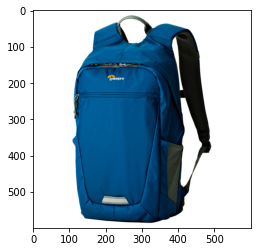

In [ ]:
r = requests.get('https://img.mvideo.ru/Pdb/10010523b.jpg')
im = Image.open(BytesIO(r.content))
plt.imshow(im)

In [ ]:
Int["page_type"].value_counts()

PRODUCT     602024
CART         35396
PURCHASE      8715
Name: page_type, dtype: int64

In [ ]:
items.shape

(4185, 2)

In [ ]:
Int = Int.merge(items[["picture_url", "text"]].drop_duplicates(), on=["picture_url"])

In [ ]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

# Холодный старт

# Самые популярные

Посмотрим, какие товары у нас самые популярные в разных разрезах (просмотр / корзина / покупка) 

In [ ]:
class Top():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def top_items(self):
        # Хотим получить в отсортированном порядке датафрейм - product_id, user_number
        items = self.interactions[self.interactions["page_type"] == "CART"]\
                                                .groupby("product_id")["vid"].count() \
                                                .reset_index() \
                                                .sort_values("vid", ascending=False)[:30]
        
        rec_imaging(items["product_id"].values, self.product_id_to_url, items["vid"].values)

In [ ]:
T = Top(Int)

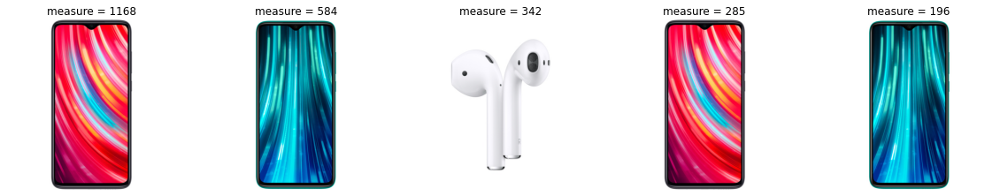

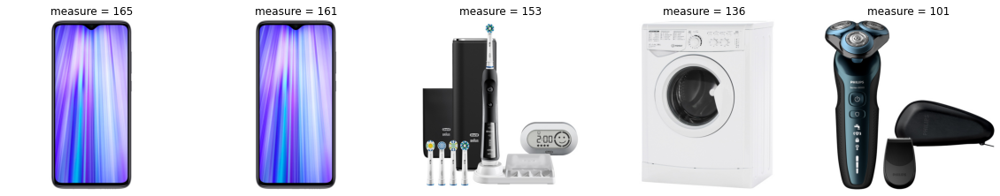

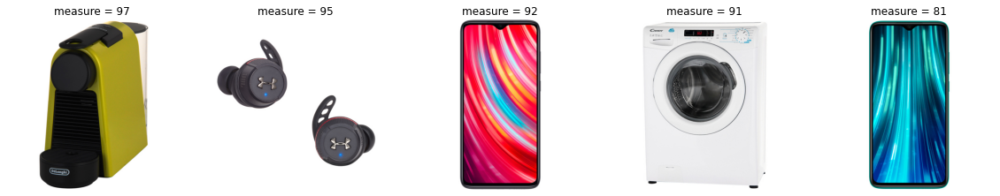

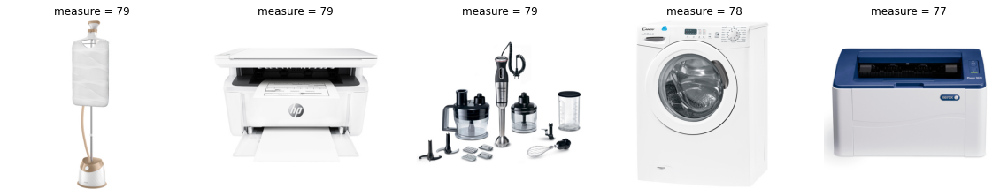

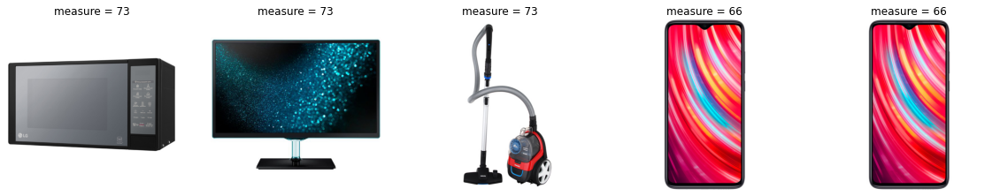

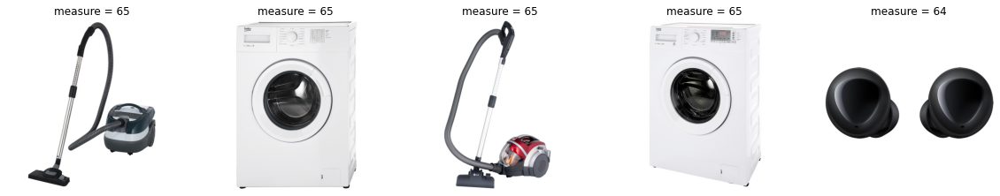

In [ ]:
T.top_items()

# Cовстречаемость

In [ ]:
Int_tmp = Int[["vid", "product_id"]].drop_duplicates()

In [ ]:
Int_tmp.head()

,vid,product_id
0,0,0
5,1,0
6,2,0
10,21291,245
12,22367,245


In [ ]:
user_products = Int_tmp.groupby(["vid"])["product_id"].apply(list).reset_index()

In [ ]:
user_products[:3]

,vid,product_id
0,0,[0]
1,1,"[0, 42341]"
2,2,"[0, 48833, 37522, 49883, 42341, 48743]"


In [ ]:
class Recomendations():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()
        # Для каждого пользователя собираем товары, с которыми он взамиодействовал
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        # Считаем число товаров, с которыми взаимодействовал каждый пользователь и записываем в колонку prod_num
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        # Фильтруем пользователей, взаимодействовавших с одним товаром
        user_products = user_products[user_products["prod_num"] > 1]
        
        # Заводим словарь под товары
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
        cooc_list = []
        for i, j in cooc.items():
            # Если товары встетились вместе больше одного раза, то добавляем в список
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [ ]:
cooc_rec = Recomendations(Int)
cooc_rec.coocurrency_count()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


In [ ]:
cooc_rec.cooc_rec.sort_values("measure", ascending=False)

,item1,item2,measure
228,1181,381,1214
229,381,1181,1214
709,381,384,1101
718,384,381,1101
6012,384,1181,905
...,...,...,...
55436,25317,10448,2
55437,25317,25316,2
55438,253,27324,2
55439,3453,27324,2


Для товара


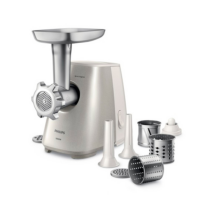

Такие рекомендации


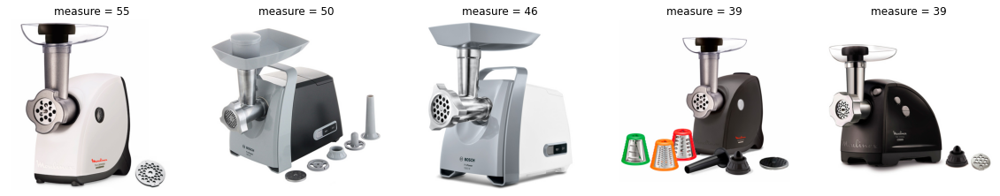

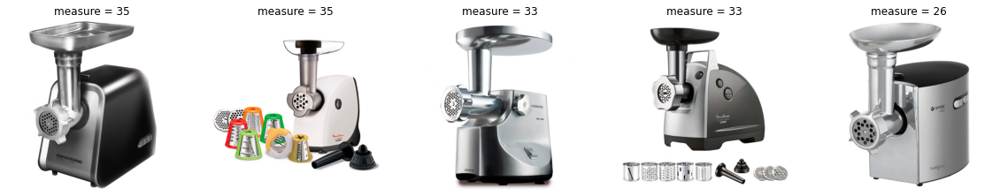

In [ ]:
cooc_rec.get_rec(10)

Для товара


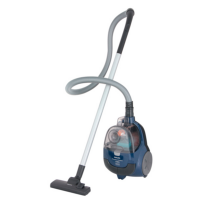

Такие рекомендации


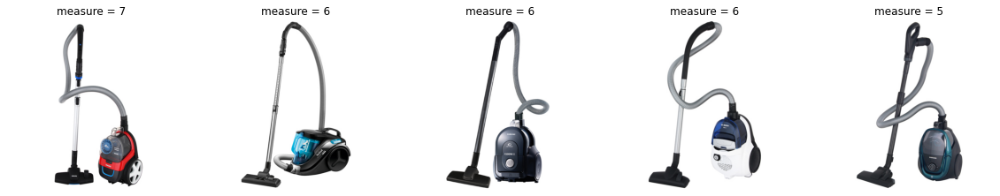

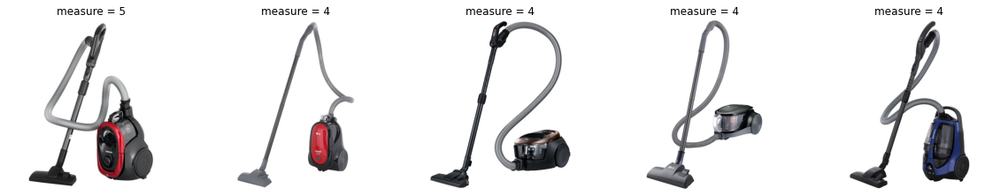

In [ ]:
cooc_rec.get_rec(121)

Для товара


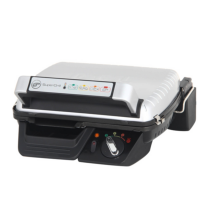

Такие рекомендации


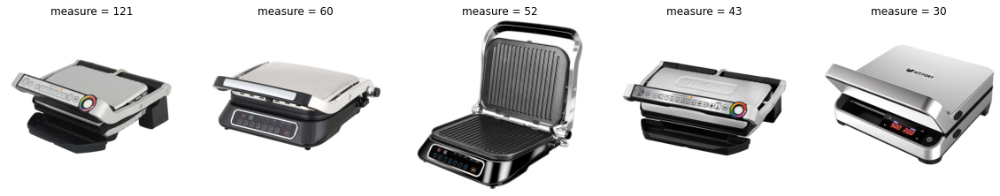

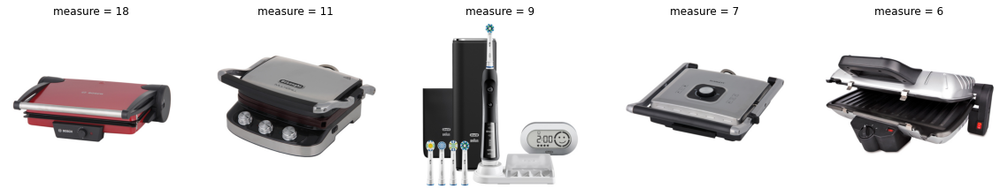

In [ ]:
cooc_rec.get_rec(42)

# Content-based

In [ ]:
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions.drop_duplicates()
        self.content_dict = {}
        for i, j in enumerate(items["picture_url"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['text']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(
                item_description,
                size=200,
                window=10,
                min_count=1,
                workers=10,
                iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["text"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

In [ ]:
" ".join(Int[Int["vid"] == 121]["text"])

'20061538 282 tia 14 450 indesit холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061744 115 cx 343 332 516 nordfrost холодильник холодильники с верхней морозильной камерой 20061745 106 cx 343 732 450 nordfrost холодильник холодильники с верхней морозильной камерой 20061753 151 cx 341 332 510 nordfrost холодильник холодильники с верхней морозильной камерой'

In [ ]:
items

,text,picture_url
0,10001833 98 monitor mr centre black oak 270 mo...,https://img.mvideo.ru/Pdb/10001833b.jpg
1,10002048 1 70997b00 300 loewe оборудование и а...,https://img.mvideo.ru/Pdb/10002048b.jpg
2,10005945 18 cybershot h300 510 sony фотоаппара...,https://img.mvideo.ru/Pdb/10005945b.jpg
3,10006755 27 ue24h4070au 360 samsung телевизор ...,https://img.mvideo.ru/Pdb/10006755b.jpg
4,10007083 53 nga5290 450 national geographic рю...,https://img.mvideo.ru/Pdb/10007083b.jpg
...,...,...
4180,10008934 9 ntk 50fhd 180 sho me видеорегистрат...,https://img.mvideo.ru/Pdb/10008934b.jpg
4181,30024821 29 nw ws413c 240 sony наушники плеер ...,https://img.mvideo.ru/Pdb/30024821b.jpg
4182,30040249 89 276e9qdsb 00 339 philips монитор м...,https://img.mvideo.ru/Pdb/30040249b.jpg
4183,50066449 1 siena 3л bronze zca31231cf 174 zanu...,https://img.mvideo.ru/Pdb/50066449b.jpg


In [ ]:
Int

,vid,product_id,page_type,picture_url,text
0,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
1,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
2,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
3,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
4,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
...,...,...,...,...,...
646130,129903,60018,PRODUCT,https://img.mvideo.ru/Pdb/50129703b.jpg,50129703 84 iphone 11 pro max leather folio au...
646131,129903,60018,PRODUCT,https://img.mvideo.ru/Pdb/50129703b.jpg,50129703 84 iphone 11 pro max leather folio au...
646132,129906,60021,PRODUCT,https://img.mvideo.ru/Pdb/50050599b.jpg,50050599 8 c6t cs cv248 ao 32wfr 195 ezviz ip ...
646133,129906,60021,PRODUCT,https://img.mvideo.ru/Pdb/50050599b.jpg,50050599 8 c6t cs cv248 ao 32wfr 195 ezviz ip ...


In [ ]:
CB = Content_Based(items, Int)

In [ ]:
CB.get_items_representation()

Для товара


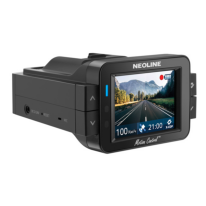

Такие рекомендации


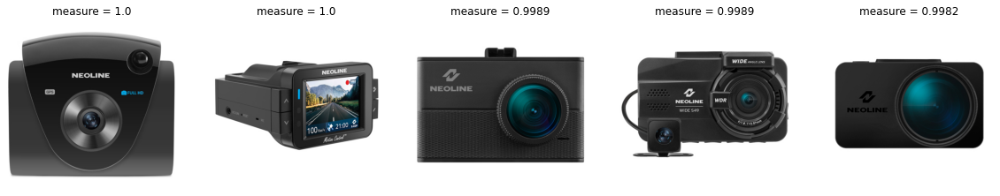

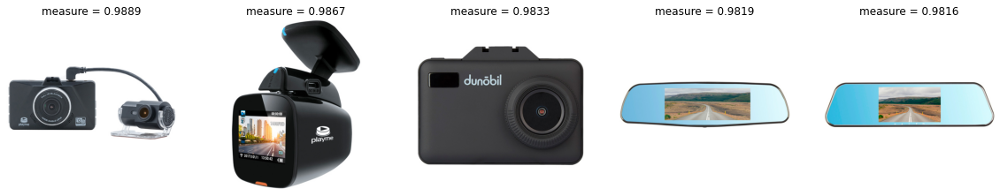

In [ ]:
CB.get_rec_I2I(13)

Для пользователя, который взаимодействовал с товарами


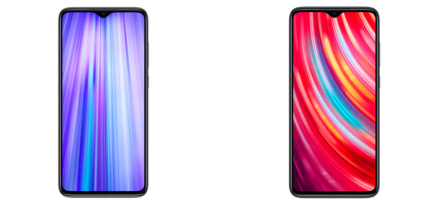

Такие рекомендации


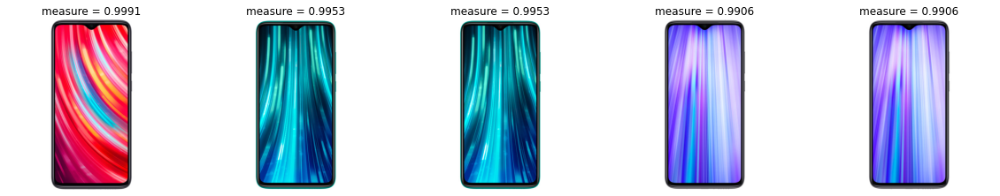

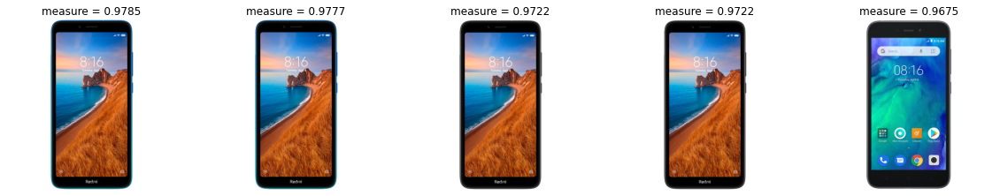

In [ ]:
CB.get_rec_U2I(13)

# W2V recommendations

In [ ]:
class W2V_REC():
    def __init__(self, interactions):
        self.interactions = interactions
        self.interactions["product_id"] = self.interactions["product_id"].astype(str)
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j

    def get_w2v(self):
        interactions_sentences = self.interactions.groupby(["vid"])["product_id"].apply(list).reset_index()
        self.model = gensim.models.Word2Vec(
                                        interactions_sentences["product_id"].apply(list).values,
                                        size=200,
                                        window=10,
                                        min_count=1,
                                        workers=10,
                                        iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        
    def avg_feature_vector(self, words):
        feature_vec = np.zeros(200, dtype='float32')
        n_words = 0
        for word in words:
            if word in self.index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, self.model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec
    
    def get_rec_I2I(self, i):
        i = str(i)
        metrics = [j[1] for j in self.model.wv.similar_by_word(i)]
        items = [j[0] for j in self.model.wv.similar_by_word(i)]
        print(u"Для товара")
        r = requests.get(self.content_dict[i])
        im = Image.open(BytesIO(r.content))
        plt.imshow(im)
        plt.axis('off')
        plt.show()
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

    def get_rec_U2I(self, i):
        user_items = list(self.interactions[self.interactions["vid"] == i]["product_id"].drop_duplicates())
        user_emb = self.avg_feature_vector(user_items)
        recs = self.model.wv.most_similar(positive=[user_emb], topn=10)
        metrics = [j[1] for j in recs]
        items = [j[0] for j in recs]
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(user_items, self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

In [ ]:
w = W2V_REC(Int)
w.get_w2v()

Для товара


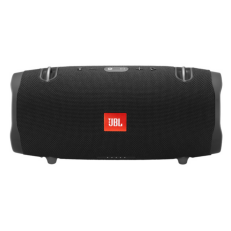

Такие рекомендации


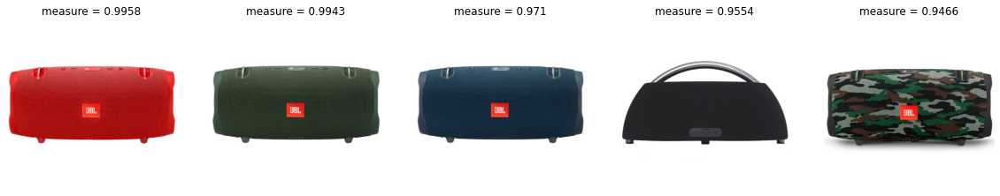

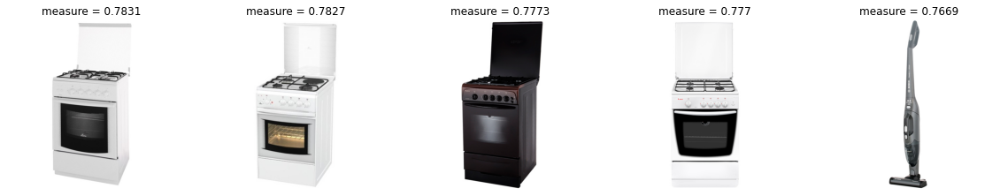

In [ ]:
w.get_rec_I2I(0)

Для товара


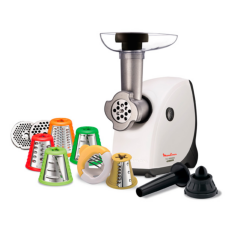

Такие рекомендации


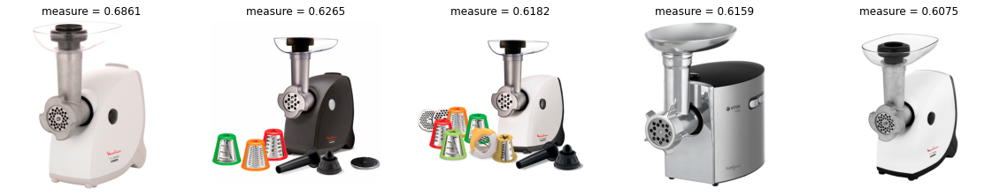

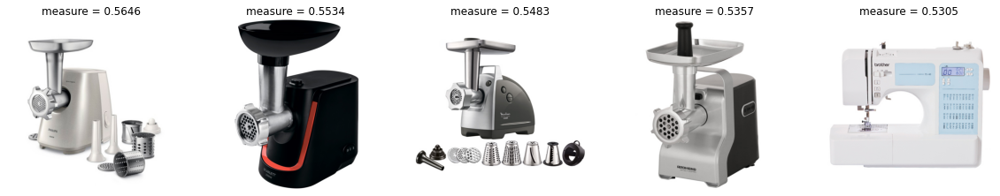

In [ ]:
w.get_rec_I2I(13)

Для товара


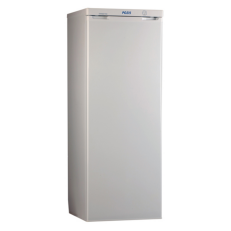

Такие рекомендации


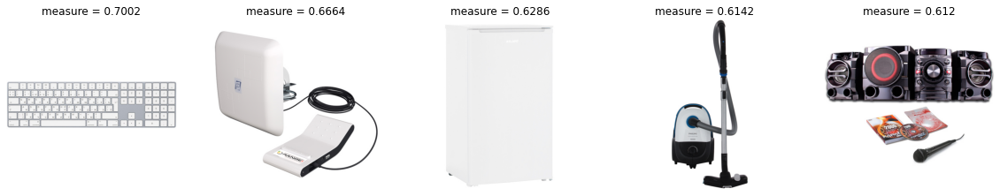

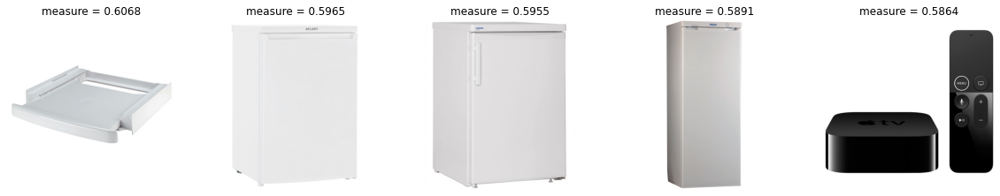

In [ ]:
w.get_rec_I2I(666)

Для пользователя, который взаимодействовал с товарами


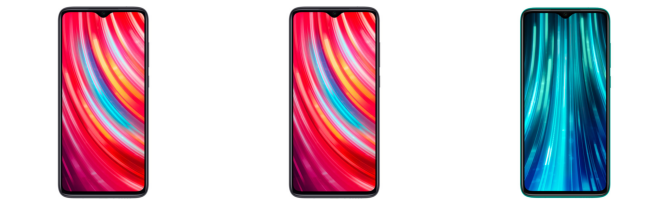

Такие рекомендации


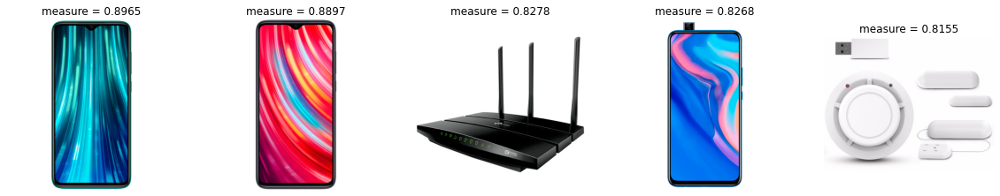

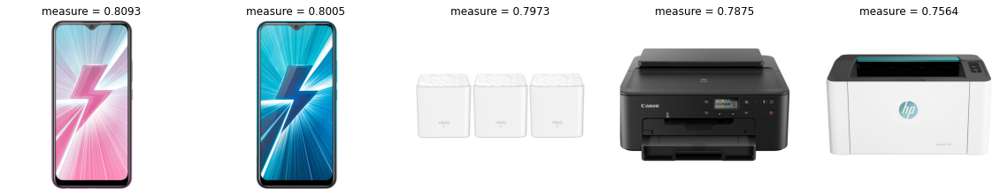

In [ ]:
w.get_rec_U2I(42)

Для пользователя, который взаимодействовал с товарами


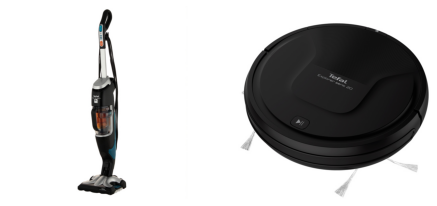

Такие рекомендации


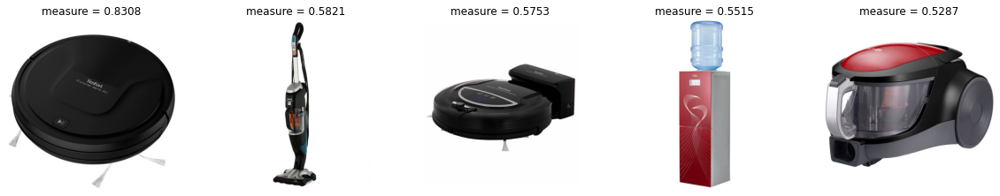

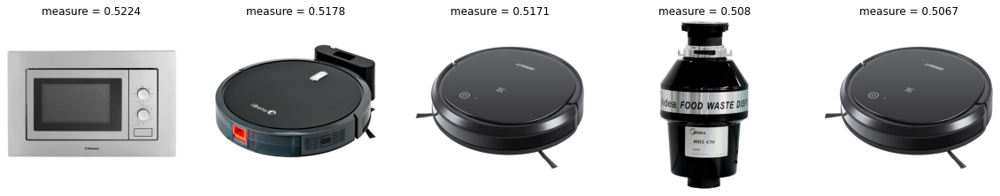

In [ ]:
w.get_rec_U2I(4322)

Для пользователя, который взаимодействовал с товарами


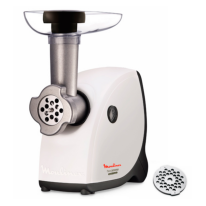

Такие рекомендации


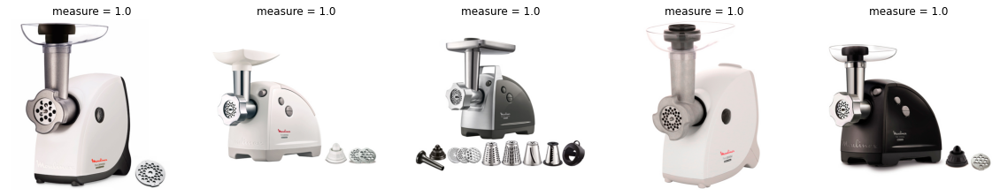

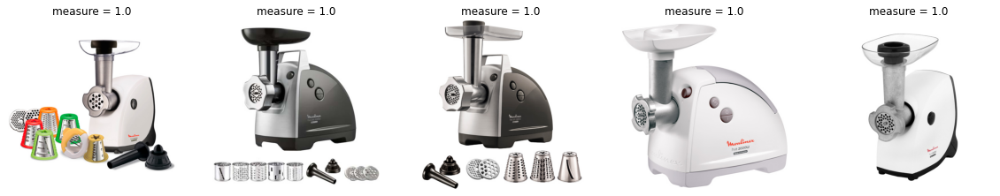

Для пользователя, который взаимодействовал с товарами


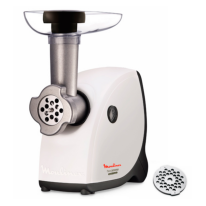

Такие рекомендации


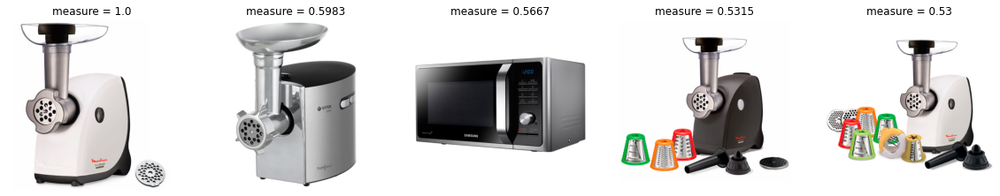

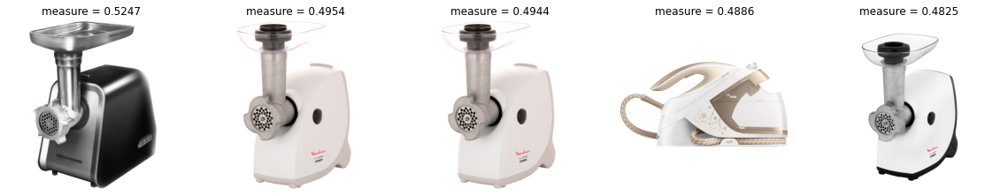

In [ ]:
user = 555
CB.get_rec_U2I(user)
w.get_rec_U2I(user)

# Colloborative filtering

In [ ]:
# Для простоты положим, что вес у всех типов взаимодействий одинаковый
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 1, 1]})

weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .sum()\
                  .reset_index()

weighted["weight"] = (weighted["weight"] > 0).astype(int)

# заполним sparse матрицу
csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                    shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))

user_rates = csr_rates.getrow(12).toarray()[0]

measure = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)

np.sort(measure.ravel())

user_rates = csr_rates.getrow(0).toarray()[0]
watched_items = np.where(user_rates != 0)[0]
metrics = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)
# домножаем оценки пользователя на коэффициент похожести
rates = csr_matrix.multiply(csr_rates.copy(), metrics)

user_rates, metrics

In [ ]:
ex_df = pd.DataFrame([[1, 0, 0, 1, 0, 0],
              [0, 0, 0, 1, 0, 1],
              [1, 1, 0, 1, 0, 1],
              [0, 0, 0, 0, 1, 1],
              [0, 0, 0, 0, 1, 1],
              [1, 1, 0, 1, 0, 1]], columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"],
            index=["Вася", "Петя", "Паша", "Олег", "Марина", "Вероника"])

In [ ]:
ex_df

,яблоко,груша,апельсин,ананас,кокос,виноград
Вася,1,0,0,1,0,0
Петя,0,0,0,1,0,1
Паша,1,1,0,1,0,1
Олег,0,0,0,0,1,1
Марина,0,0,0,0,1,1
Вероника,1,1,0,1,0,1


In [ ]:
user_rates = ex_df.iloc[1].values

In [ ]:
user_rates

array([0, 0, 0, 1, 0, 1])

In [ ]:
metrics = cosine_similarity([user_rates], ex_df.values).reshape(-1, 1)

In [ ]:
metrics

array([[0.5       ],
       [1.        ],
       [0.70710678],
       [0.5       ],
       [0.5       ],
       [0.70710678]])

In [ ]:
rates = ex_df.values * metrics

In [ ]:
pd.DataFrame(rates, columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"],
            index=["Вася", "Петя", "Паша", "Олег", "Марина", "Вероника"])

,яблоко,груша,апельсин,ананас,кокос,виноград
Вася,0.500000,0.000000,0.0,0.500000,0.0,0.000000
Петя,0.000000,0.000000,0.0,1.000000,0.0,1.000000
Паша,0.707107,0.707107,0.0,0.707107,0.0,0.707107
Олег,0.000000,0.000000,0.0,0.000000,0.5,0.500000
Марина,0.000000,0.000000,0.0,0.000000,0.5,0.500000
Вероника,0.707107,0.707107,0.0,0.707107,0.0,0.707107


In [ ]:
total_rate = np.array(np.sum(rates, axis=0))

In [ ]:
total_rate

array([1.91421356, 1.41421356, 0.        , 2.91421356, 1.        ,
       3.41421356])

In [ ]:
watched_items = np.where(user_rates != 0)[0]

In [ ]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        

    def user_based(self, idx):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        # считаем косинус между пользователем idx и всеми пользователями
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def item_based(self, idx):
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        # считаем косинус между товаром idx и всеми пользователями
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [ ]:
clb = Colloborative(Int)

Для таких товаров


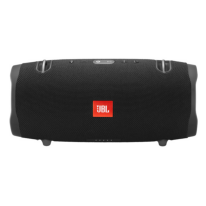

Такие рекомендации


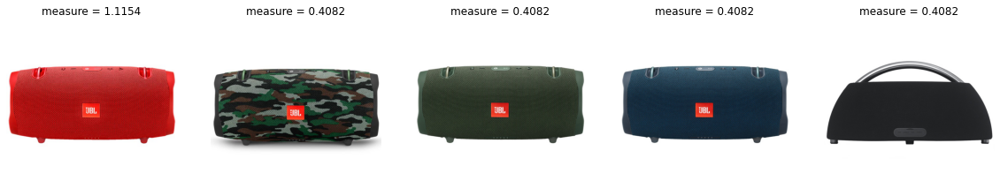

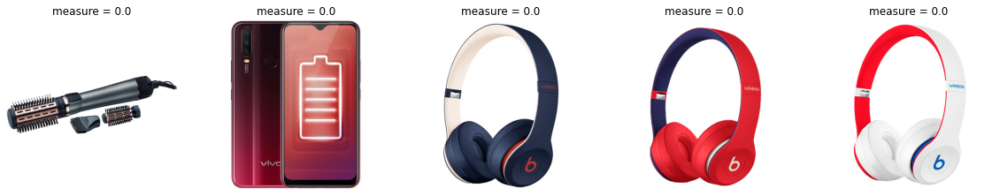

In [ ]:
clb.user_based(0)

Для таких товаров


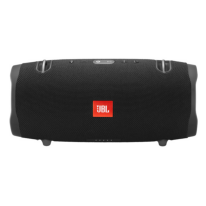

Такие рекомендации


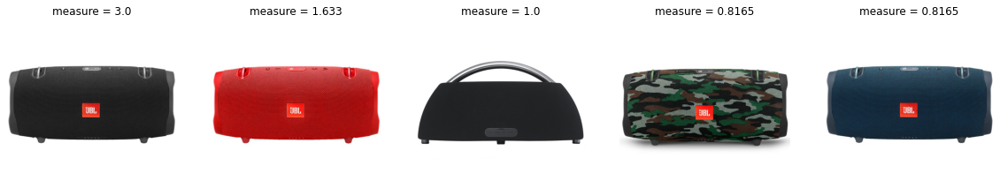

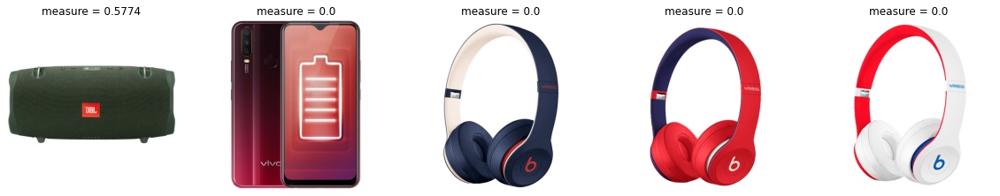

In [ ]:
clb.item_based(0)

Для таких товаров


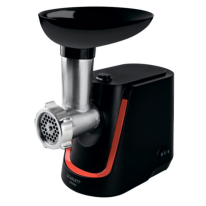

Такие рекомендации


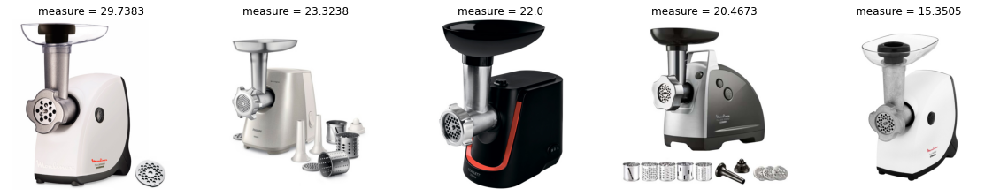

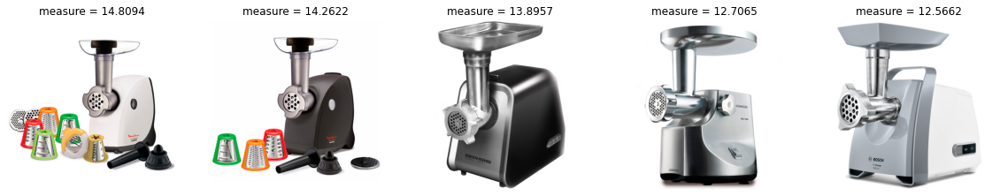

In [ ]:
clb.item_based(12)

Для таких товаров


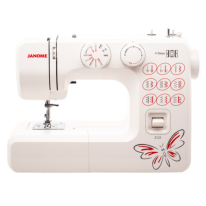

Такие рекомендации


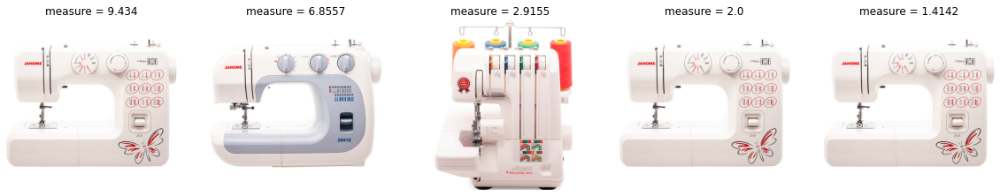

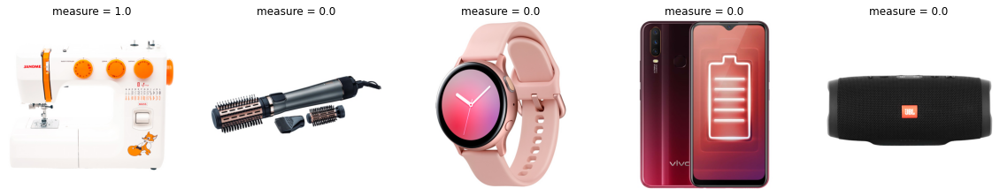

In [ ]:
clb.item_based(31211)

Для таких товаров


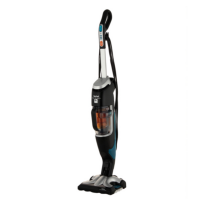

Такие рекомендации


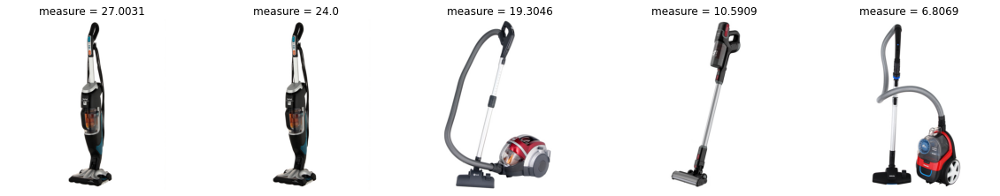

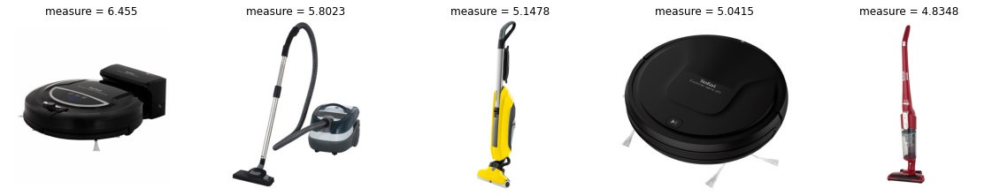

In [ ]:
clb.item_based(2556)

Для таких товаров


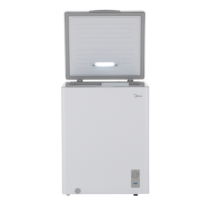

Такие рекомендации


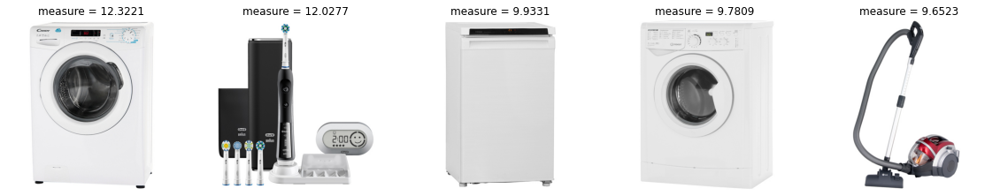

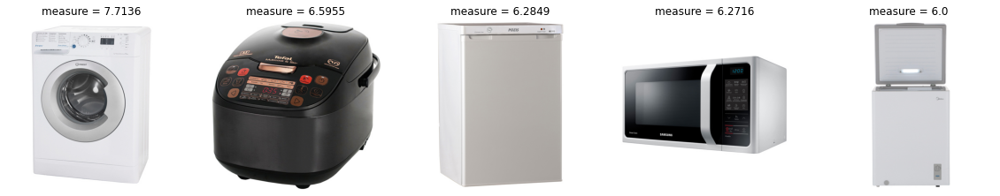

In [ ]:
clb.item_based(404)

Для таких товаров


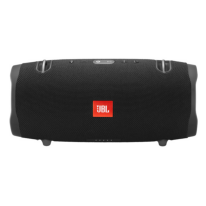

Такие рекомендации


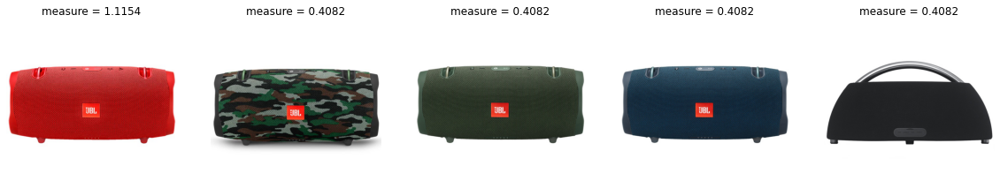

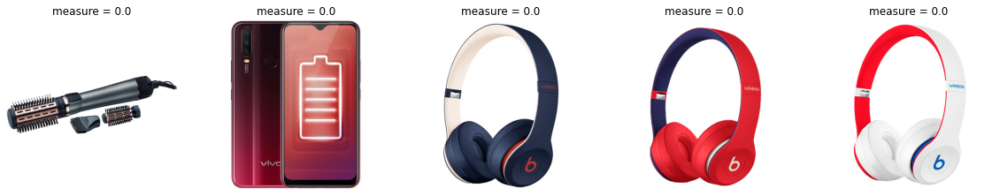

In [ ]:
clb.user_based(0)

Для таких товаров


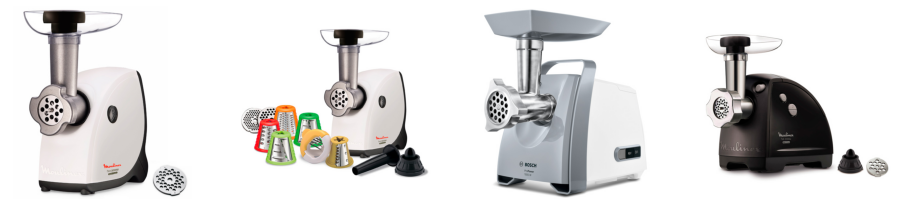

Такие рекомендации


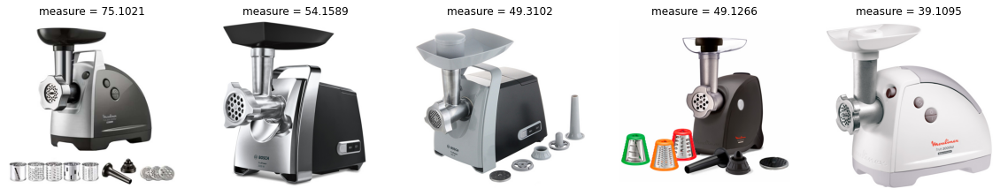

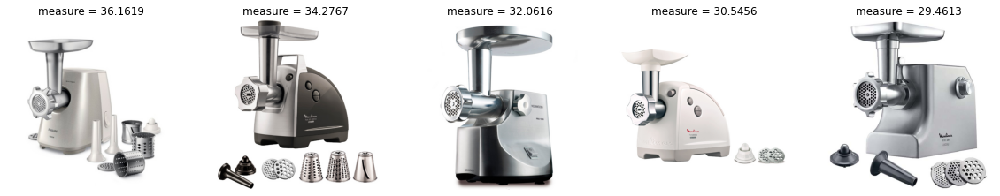

In [ ]:
clb.user_based(404)

Для таких товаров


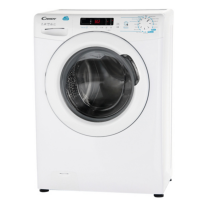

Такие рекомендации


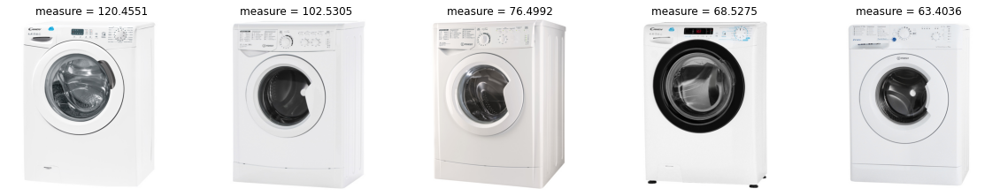

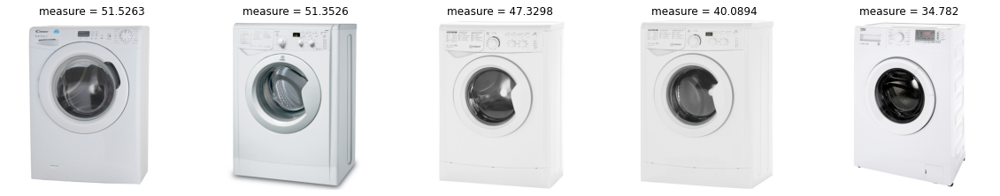

In [ ]:
clb.user_based(12345)

Для таких товаров


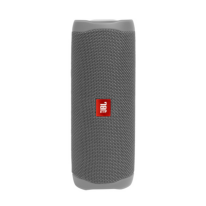

Такие рекомендации


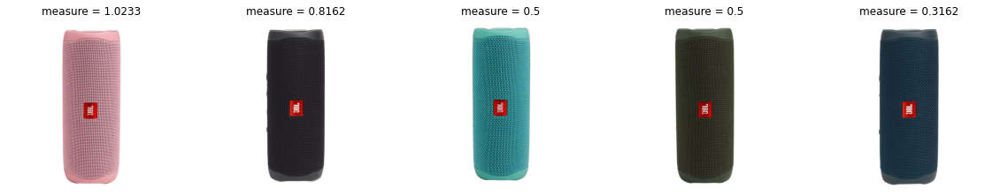

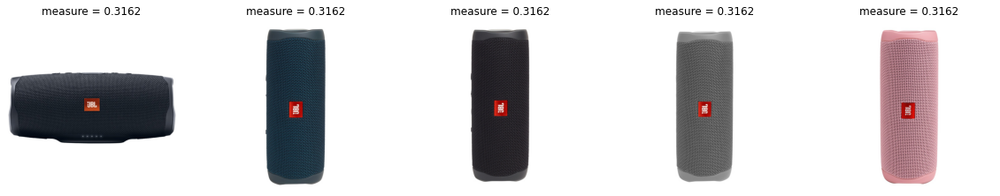

In [ ]:
clb.user_based(123456)

Для таких товаров


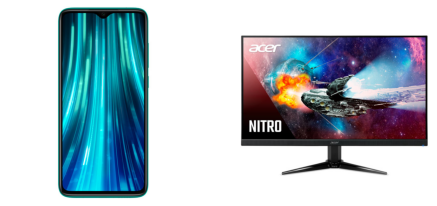

Такие рекомендации


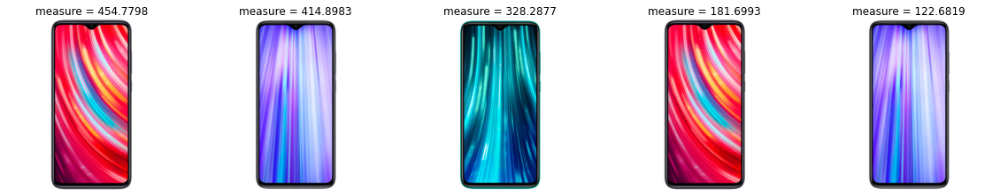

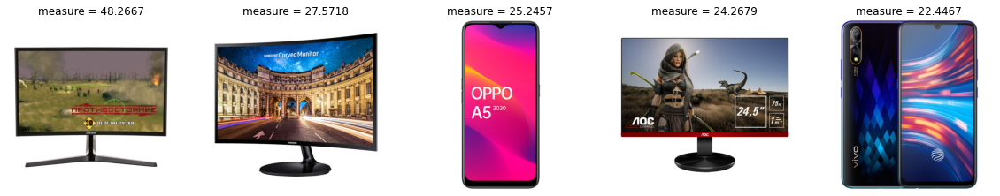

In [ ]:
clb.user_based(34434)

Для таких товаров


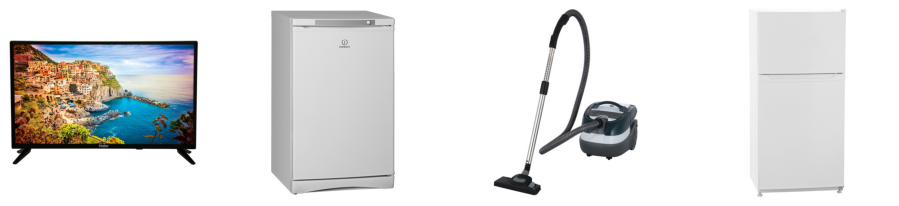

Такие рекомендации


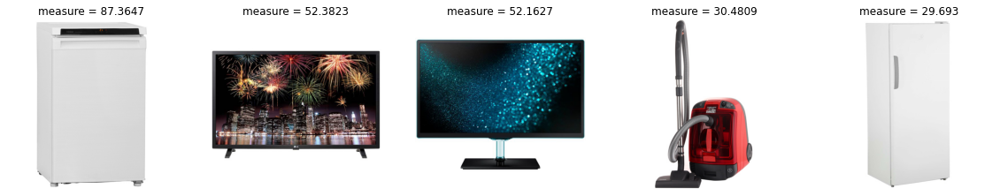

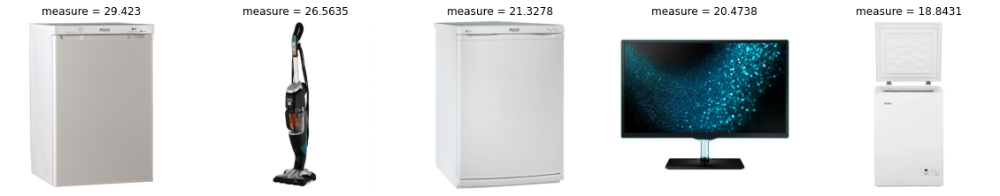

In [ ]:
clb.user_based(3333)

Для таких товаров


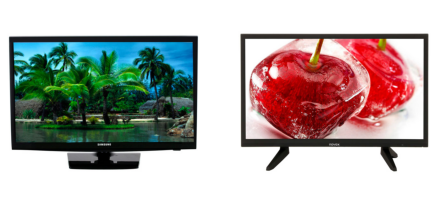

Такие рекомендации


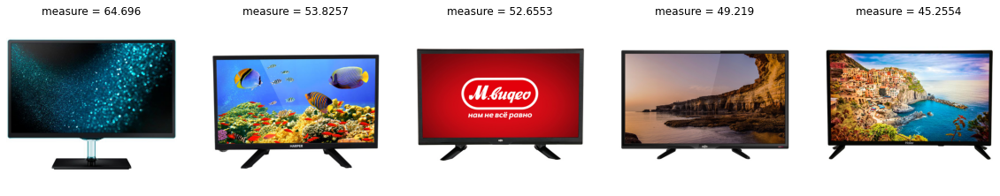

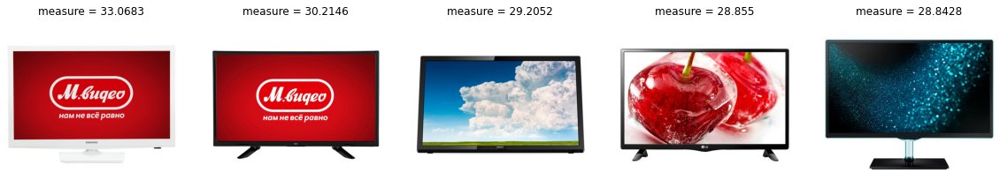

In [ ]:
clb.user_based(5555)

Для таких товаров


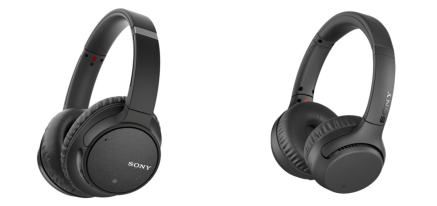

Такие рекомендации


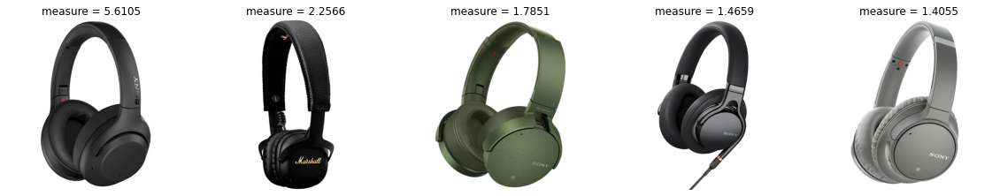

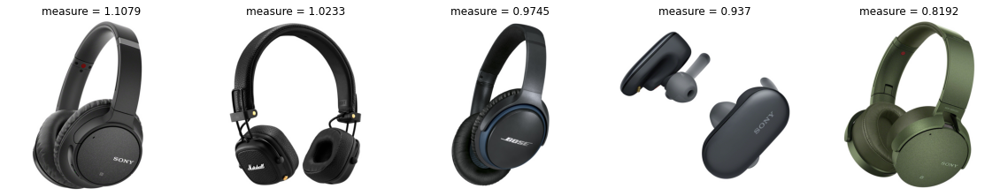

In [ ]:
clb.user_based(77777)

Для таких товаров


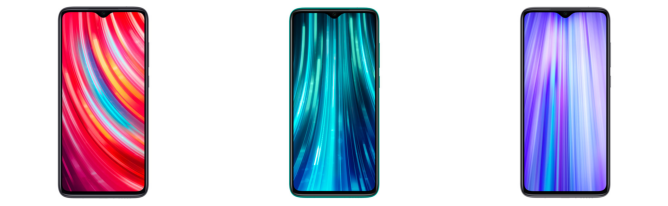

Такие рекомендации


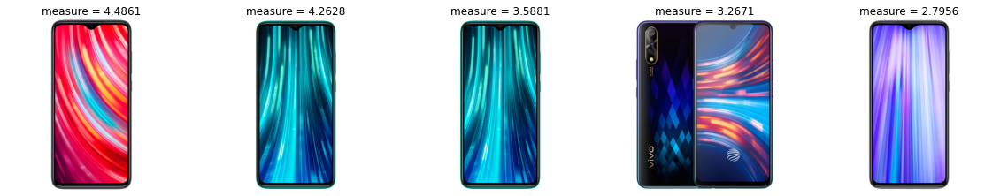

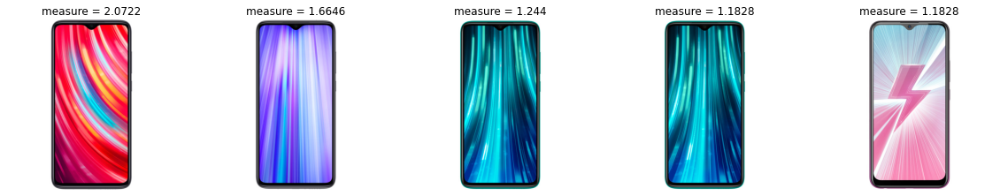

In [ ]:
clb.user_based(5)

Для таких товаров


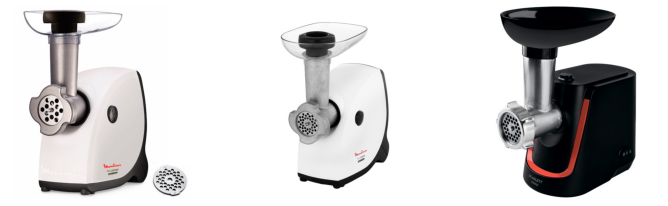

Такие рекомендации


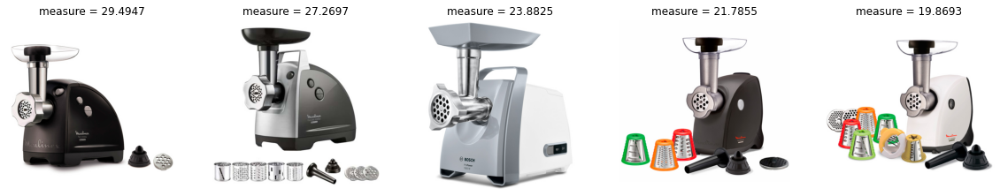

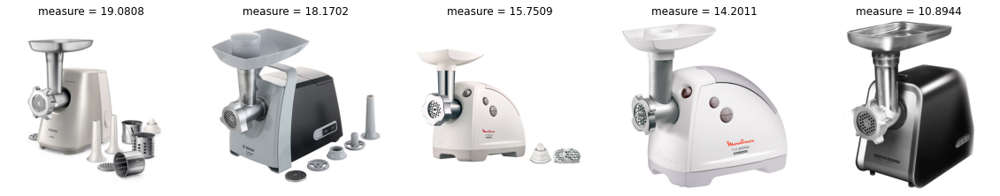

In [ ]:
clb.user_based(323)

# Matrix Factorization

In [ ]:
class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

In [ ]:
simple_svd = MatrixFactorization(Int, 30)
simple_svd.MF()

Для товара


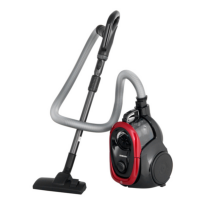

Такие рекомендации


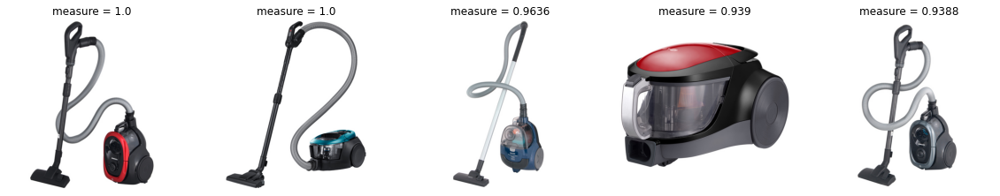

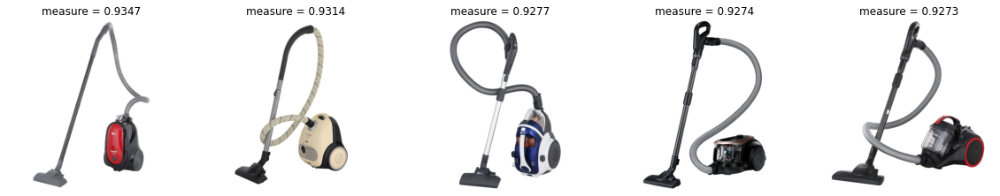

In [ ]:
simple_svd.get_rec(122)

Для товара


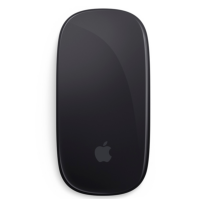

Такие рекомендации


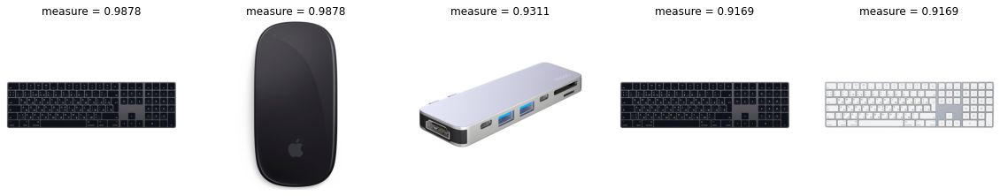

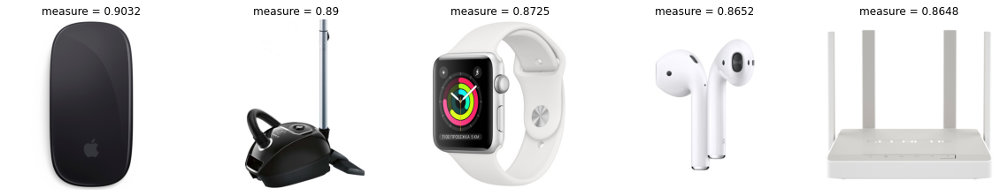

In [ ]:
simple_svd.get_rec(402)

Для товара


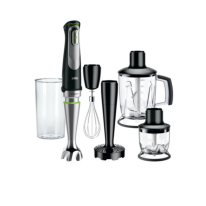

Такие рекомендации


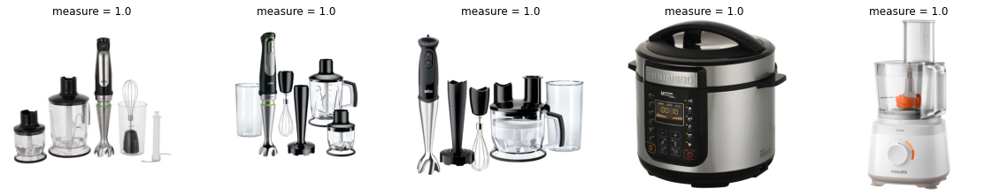

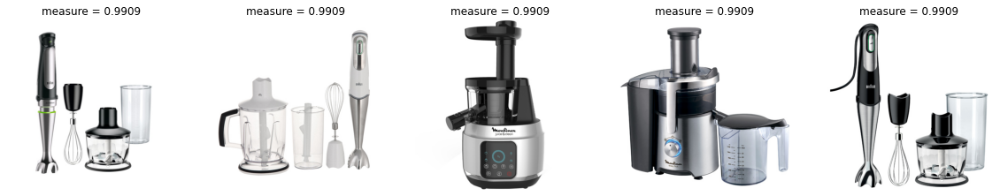

In [ ]:
simple_svd.get_rec(10022)

Для товара


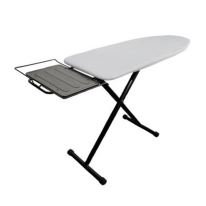

Такие рекомендации


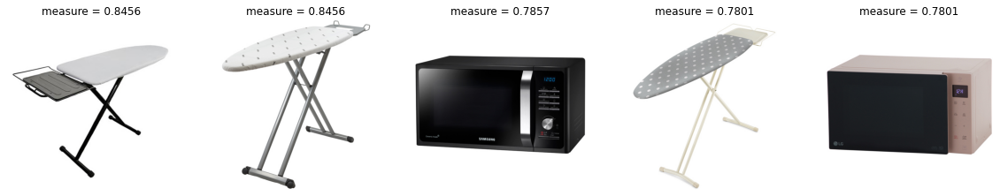

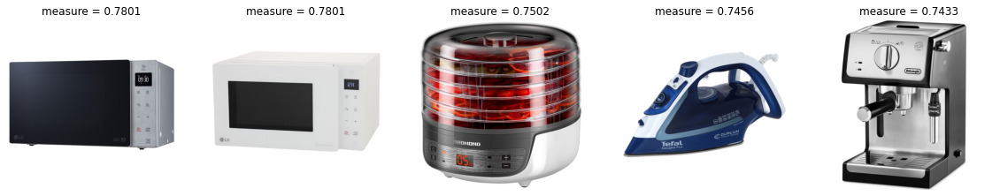

In [ ]:
simple_svd.get_rec(406)

# LightFM

In [ ]:
mf = MatrixFactorization(Int, 300)
mf.LightFM()

Epoch: 100%|██████████| 5/5 [00:11<00:00,  2.30s/it]


Для товара


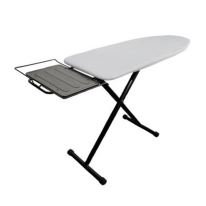

Такие рекомендации


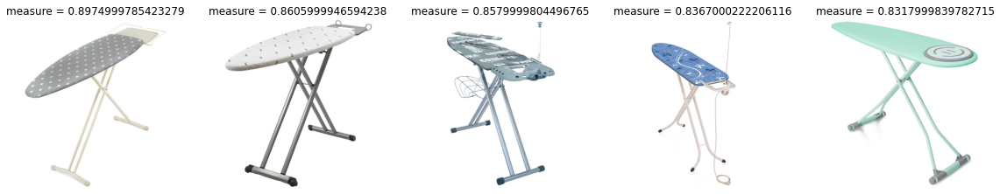

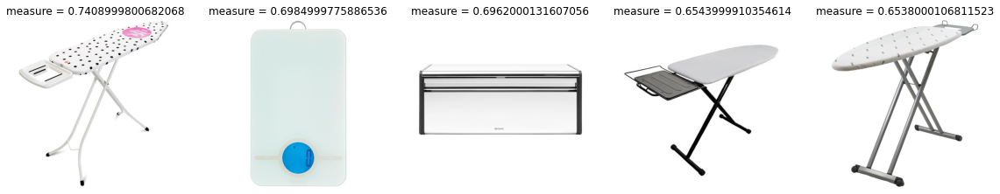

In [ ]:
mf.get_rec(406)

Для товара


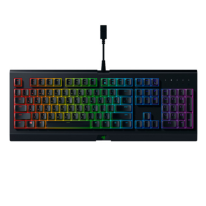

Такие рекомендации


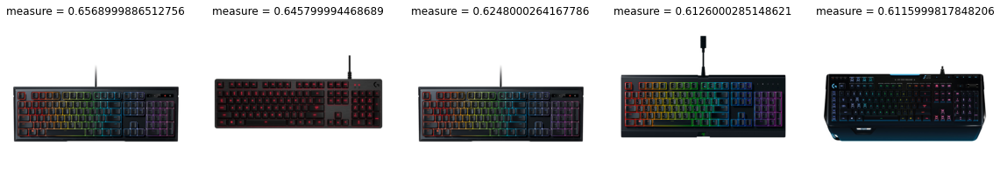

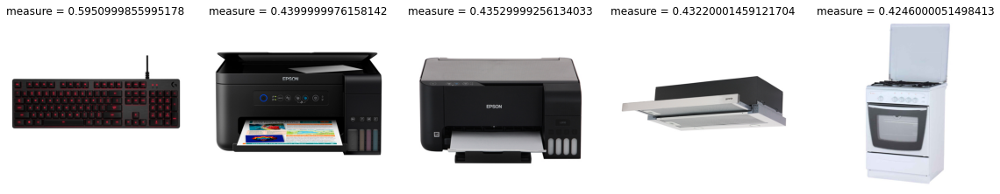

In [ ]:
mf.get_rec(1234)

# ALS

$\min\limits_{q^*,p^*}\sum\limits_{u,i}(r_{ui} - q_i^Tp_u)^2 + \lambda(||q_i||^2 + ||p_u||^2)$

In [ ]:
LATENT_SIZE = 100

lambda_p = 0.2
lambda_q = 0.01

Посчитаем количество пользователей и товаров

In [ ]:
n_users = Int["vid"].value_counts().shape[0]
n_items = Int["product_id"].value_counts().shape[0]

Инициализируем латентные представления для пользователей и товаров

In [ ]:
p = 0.1 * np.random.random((n_users, LATENT_SIZE))
q = 0.1 * np.random.random((n_items, LATENT_SIZE))

In [ ]:
from collections import defaultdict

In [ ]:
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 5, 20]})
weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .max()\
                  .reset_index()

In [ ]:
weighted.head()

,vid,product_id,picture_url,weight
0,0,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
1,1,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
2,1,42341,https://img.mvideo.ru/Pdb/10020865b.jpg,1
3,2,0,https://img.mvideo.ru/Pdb/10018823b.jpg,1
4,2,37522,https://img.mvideo.ru/Pdb/10018824b.jpg,1


Составим словарь взаимодействий по товару

In [ ]:
train_by_item = defaultdict(list)
for u, i, _, r in weighted.values:
    train_by_item[i].append((u, r))

Составим словарь взаимодействий по пользователю

In [ ]:
train_by_user = defaultdict(list)
for u, i, _, r in weighted.values:
    train_by_user[u].append((i, r))

Теперь составим матрицу $P$ из векторов $p_u$ и матрицу Q из векторов $q_i$. Матрицей $Q[u] \in \mathbb{R}^{n_u \times K}$ будем обозначать подматрицу матрицы $Q$ только для товаров, оцененных пользователем $u$, где $n_u$ - количество оценок пользователя $u$.

Шаг перенастройки $p_u$ при фиксированной матрице $Q$ будет выглядеть следующим образом:


$$
A_u = Q[u]^TQ[u]
$$

$$
d_u = Q[u]^Tr_u
$$

$$
p_u = (\lambda_pI + A_u)^{-1}d_u
$$


In [ ]:
def compute_p(p, q, train_by_user):
    for u, rated in train_by_user.items():
        rated_items = [i for i, _ in rated]
        Au = q[rated_items].T.dot(q[rated_items])
        ratings = [i for _, i in rated]
        du = q[rated_items].T.dot(ratings)
        p[u] = np.linalg.inv(lambda_p * np.eye(Au.shape[0]) + Au).dot(du)
    return p

Шаг для перенастройки $q_i$ при фиксированной матрице $P$ будет считаться аналогично

In [ ]:
def compute_q(p, q, train_by_item):
    for i, rated in train_by_item.items():
        rated_users = [u for u, _ in rated]
        Au = p[rated_users].T.dot(p[rated_users])
        ratings = [u for _, u in rated]
        du = p[rated_users].T.dot(ratings)
        q[i] = np.linalg.inv(lambda_q * np.eye(Au.shape[0]) + Au).dot(du)
    return q

In [ ]:
from tqdm.notebook import tqdm_notebook

In [ ]:
for i in tqdm_notebook(range(20)):
    p = compute_p(p, q, train_by_user)
    q = compute_q(p, q, train_by_item)

KeyboardInterrupt: ignored

In [ ]:
np.save("q.npy", q)

In [ ]:
q = np.load("q.npy")

In [ ]:
product_id_to_url = {}
for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
    product_id_to_url[i[0]] = i[1]

In [ ]:
def get_rec_I2I(q, i):
    metrics = cosine_similarity([q[i]], q)
    print(u"Для товара")
    rec_imaging([i], product_id_to_url)
    print(u"Такие рекомендации")
    rec_imaging(np.argsort(metrics)[0][::-1][1:6], product_id_to_url, np.sort(metrics)[0][::-1][1:6])

In [ ]:
get_rec_I2I(q, 9343)

In [ ]:
get_rec_I2I(q, 50000)

In [ ]:
get_rec_I2I(q, 6593)

In [ ]:
get_rec_I2I(q, 1000)

# Домашнее задание

Data contains the book rating information. Ratings (Book-Rating) are either explicit, expressed on a scale from 1-10 (higher values denoting higher appreciation), or implicit, expressed by 0.

### 1. Реализовать персональный топ  - принимает на вход возраст и локацию, на выходе персональный топ   - 1 балл

Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.

### 2. На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 25) - 2 балла

Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.

### 3. Применить методы расмотренные на лекции (Совстречаемость - 2 балл, Content-based - 1 балл, Коллаборативная фильтрация - 3 балла , Матричная Факторизация - 1 балл) - 7 баллов

В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок

Коллаборативную фильтрацию реализовывать как на слайде 50 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.

Если совсем сложно - можно сделать как в семинарской части, поставив оценку "0", если рейтинг < 5 и "1" - в противном случае. Тогда максимум за это - 1 балл.

Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

### Примечание:

Так как пользователей много - можно зафиксировать несколько произвольных и для них уже составлять рекомендации

Работоспособность I2I можно проверять на известных книгах (Гарри Поттер, Властелин Колец, Интервью с вампиром, Код-Да-Винчи, Маленький Принц)

Рейтинг книг обязательно нужно учитывать

Не забываем также предобработать данные - выкинуть выбросы-пользователей и выбросы-книги.

# Жесткий дедлайн 12 мая

Выводить в качестве рекомендаций лучше названия книг, картинки (если они есть) и соответствующие метрики близости.

###0 Загрузка данных и их осмотр

In [ ]:
books = pd.read_csv("BX-Books.csv")

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [ ]:
interactions = pd.read_csv("BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")

In [ ]:
interactions = interactions[interactions["Book-Rating"] != 0]

In [ ]:
interactions.head()

,User-ID,ISBN,Book-Rating
1,276726,0155061224,5
3,276729,052165615X,3
4,276729,0521795028,6
6,276736,3257224281,8
7,276737,0600570967,6


In [ ]:
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


#### Осмотр данных про книги и их предообработка

In [ ]:
books.dtypes

ISBN                   object
Book-Title             object
Book-Author            object
Year-Of-Publication    object
Publisher              object
Image-URL-S            object
Image-URL-M            object
Image-URL-L            object
dtype: object

In [ ]:
print(books.isnull().sum())
books.dropna(axis = 0, inplace = True)


ISBN                   0
Book-Title             0
Book-Author            1
Year-Of-Publication    0
Publisher              2
Image-URL-S            0
Image-URL-M            0
Image-URL-L            2
dtype: int64


In [ ]:
books['Year-Of-Publication'] = books['Year-Of-Publication'].apply(lambda x: int(x))

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


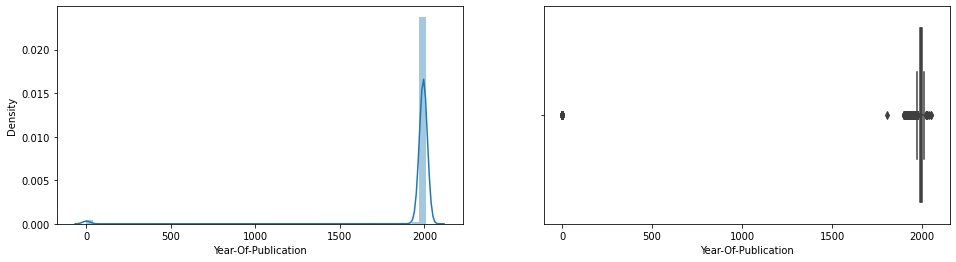

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (16, 4))
sns.distplot(books['Year-Of-Publication'], ax=ax[0])
sns.boxplot(x = books['Year-Of-Publication'], ax=ax[1])
plt.show()

Удалим выбросы (три точки год меньше 1900) и снова взглянем на график

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


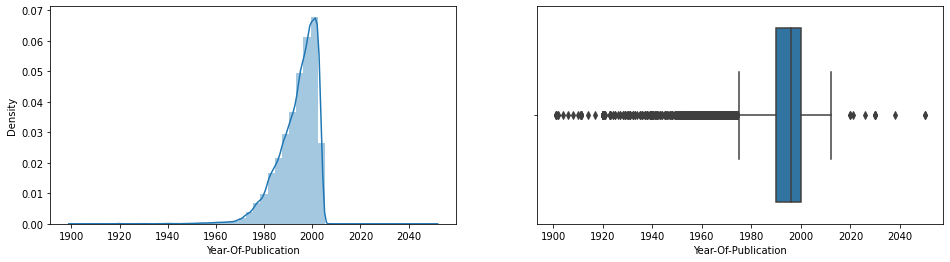

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (16, 4))
sns.distplot(books[books['Year-Of-Publication'] > 1900]['Year-Of-Publication'], ax=ax[0])
sns.boxplot(x = books[books['Year-Of-Publication'] > 1900]['Year-Of-Publication'], ax=ax[1])

Книги с годом издания больше 2021 тоже удалим

In [ ]:
new_books = books.loc[(books['Year-Of-Publication'] > 1900) &
                      (books['Year-Of-Publication'] < 2020), :]

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


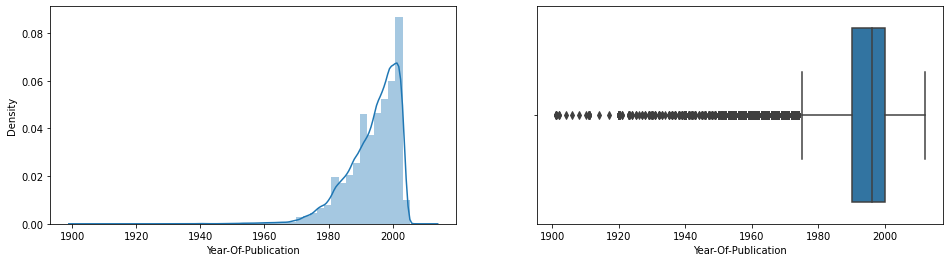

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (16, 4))
sns.distplot(new_books['Year-Of-Publication'], ax=ax[0])
sns.boxplot(x = new_books['Year-Of-Publication'], ax=ax[1])

In [ ]:
# названий в виде пустых строк нет
(new_books['Book-Author'] == '').sum(), (new_books['Book-Title'] == '').sum()

(0, 0)

#### Осмотр данных по рейтингам

In [ ]:
interactions.isnull().sum(), interactions.dtypes

(User-ID        0
 ISBN           0
 Book-Rating    0
 dtype: int64, User-ID         int64
 ISBN           object
 Book-Rating     int64
 dtype: object)

In [ ]:
interactions.describe()

,User-ID,Book-Rating
count,433671.000000,433671.000000
mean,135458.743451,7.601066
std,80678.385078,1.843798
min,8.000000,1.000000
25%,66619.000000,7.000000
50%,133184.000000,8.000000
75%,205735.000000,9.000000
max,278854.000000,10.000000


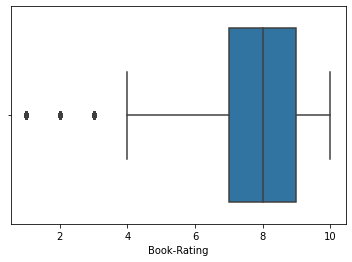

In [ ]:
sns.boxplot(x = interactions['Book-Rating'])

Матрица пользователей

In [ ]:
users = pd.read_csv('BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


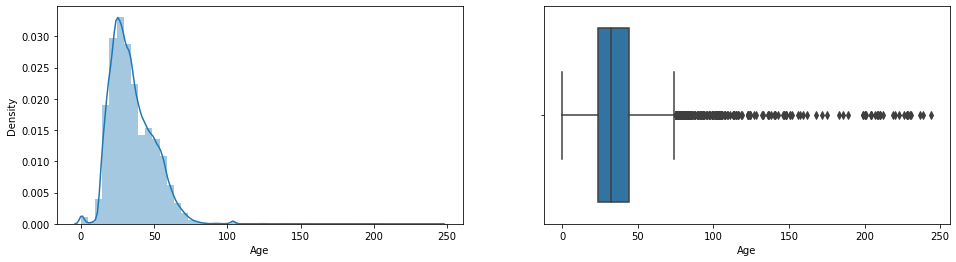

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (16, 4))
sns.distplot(users.Age, ax=ax[0])
sns.boxplot(x = users.Age, ax=ax[1])

Удалим всех кто по возрасту не попал в интервал (5, 90)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


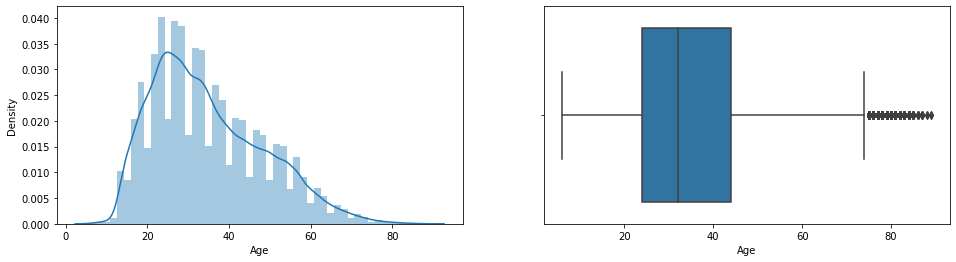

In [ ]:
users = users.loc[(users.Age > 5) &
                      (users.Age < 90), :]

fig, ax = plt.subplots(1, 2, figsize = (16, 4))
sns.distplot(users.Age, ax=ax[0])
sns.boxplot(x = users.Age, ax=ax[1])

#### Доп признаки в таблицу взаимодейтсвий

In [ ]:
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})

In [ ]:
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [ ]:
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])

In [ ]:
interactions = interactions[(interactions["user_num"] > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]

In [ ]:
interactions = interactions.merge(new_books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
    columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

In [ ]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [ ]:
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [ ]:
interactions.head()

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10267,3426
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10267,5220
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10267,2608
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10267,10830
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10267,4205


In [ ]:
csr_rates = csr_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

In [ ]:
csr_rates

<10902x10551 sparse matrix of type '<class 'numpy.longlong'>'
	with 109538 stored elements in Compressed Sparse Row format>

### Задание 1. Персональный топ

In [ ]:
users.head()

,User-ID,Location,Age
1,2,"stockton, california, usa",18.0
3,4,"porto, v.n.gaia, portugal",17.0
5,6,"santa monica, california, usa",61.0
9,10,"albacete, wisconsin, spain",26.0
10,11,"melbourne, victoria, australia",14.0


In [ ]:
users.Location.value_counts()

london, england, united kingdom         1606
sydney, new south wales, australia      1395
madrid, madrid, spain                   1318
toronto, ontario, canada                1223
melbourne, victoria, australia          1052
                                        ... 
tehran, west virginia, iran                1
béjar, salamanca, spain                    1
st austell, cornwall, united kingdom       1
niagara region, ontario, canada            1
fontana, ,                                 1
Name: Location, Length: 40967, dtype: int64

In [ ]:
ind = users.loc[(users.Location == 'london, england, united kingdom') &
                (users.Age == 40), 'User-ID']

In [ ]:
interactions[interactions['User-ID'].isin(ind)]

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
6880,269728,0553280368,9,54,195,http://images.amazon.com/images/P/0553280368.0...,C Is for Corpse (Kinsey Millhone Mysteries (Pa...,6468,10558
37500,269728,0449221490,8,47,195,http://images.amazon.com/images/P/0449221490.0...,L Is for Lawless,5201,10558
43050,269728,0140132708,7,20,195,http://images.amazon.com/images/P/0140132708.0...,Midnight's Children,855,10558
61678,269728,0060256664,10,6,195,http://images.amazon.com/images/P/0060256664.0...,The Giving Tree,174,10558
61808,269728,0765345048,10,14,195,http://images.amazon.com/images/P/0765345048.0...,Kushiel's Chosen (Kushiel's Legacy),8689,10558
63111,269728,0140013997,10,12,195,http://images.amazon.com/images/P/0140013997.0...,My Family and Other Animals.,787,10558
74905,269728,0439010780,9,8,195,http://images.amazon.com/images/P/0439010780.0...,The Shadow in the North,4147,10558
75465,269728,0060586605,9,6,195,http://images.amazon.com/images/P/0060586605.0...,A Hat Full of Sky,267,10558
75583,269728,0380791978,10,19,195,http://images.amazon.com/images/P/0380791978.0...,The Family Tree,2964,10558
76753,269728,1853260622,9,11,195,http://images.amazon.com/images/P/1853260622.0...,War and Peace (Wordsworth Classics),10082,10558


In [ ]:
class Top():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def top_items(self, age, location, table_users):
        # Хотим получить в отсортированном порядке датафрейм - product_id, user_number
        id_vid = table_users[(table_users['Age'] == age) & (table_users['Location'] == location)]['User-ID']
        items = self.interactions[self.interactions["User-ID"].isin(id_vid)]\
                                                .groupby("product_id")["vid"].count() \
                                                .reset_index() \
                                                .sort_values("vid", ascending=False)[:10]
        
        rec_imaging(items["product_id"].values, self.product_id_to_url, items["vid"].values)

In [ ]:
t = Top(interactions)

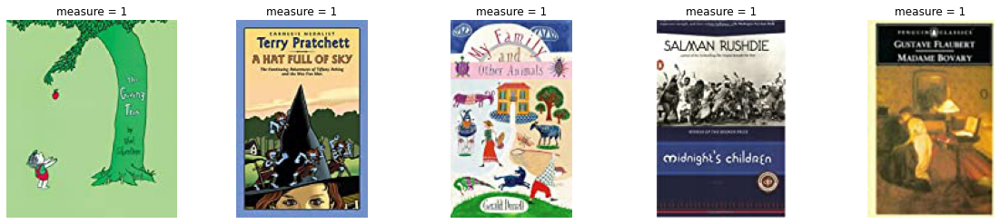

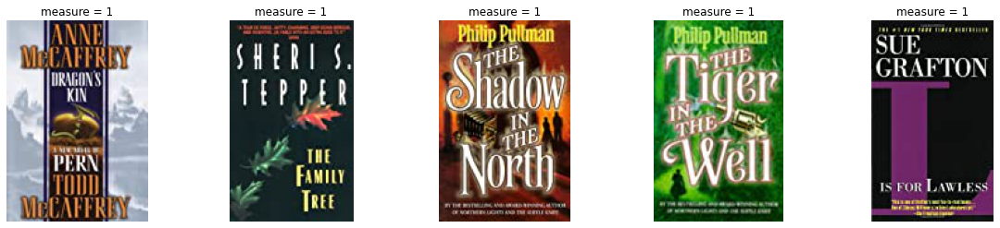

In [ ]:
t.top_items(40, 'london, england, united kingdom', users)

In [ ]:
# самодельная функция
def pers_top_books(age, location, show_pics = False):
  users_id = users.loc[(users.Location == location) & 
                       (users.Age == age), 'User-ID']

  interactive = interactions[interactions['User-ID'].isin(users_id)]
  ser = pd.DataFrame(interactive.groupby('ISBN')['User-ID'].count().reset_index())

  ser = ser.merge(interactive.loc[:, ['Book-Title', 'picture_url', 'product_id','ISBN']], on = ['ISBN'])
  ser.index = ser['ISBN']
  ser.drop('ISBN', inplace = True, axis = 1)

  
  ser['Rating(mean)'] = interactive.groupby('ISBN')['Book-Rating'].mean()
  ser['Users_num(other age groups)'] = interactive.groupby('ISBN')['user_num'].sum()
  ser.sort_values(by = ['User-ID', 'Rating(mean)', 'Users_num(other age groups)'], inplace = True, ascending = False)
  ser['Top_place'] = list(range(1, 1+ser.shape[0]))
  ser.drop('User-ID', axis = 1, inplace = True)

  if show_pics:
    print('Для таких локаций и возраста такой топ книг')
    for j in ser['picture_url']:      
      r = requests.get(j)
      im = Image.open(BytesIO(r.content))
      plt.imshow(im)
      plt.show()
  return ser

Такие рекомендации


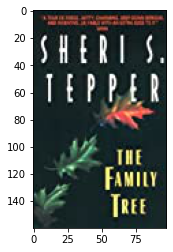

Такие рекомендации


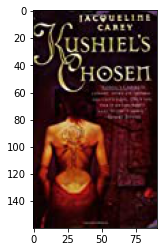

Такие рекомендации


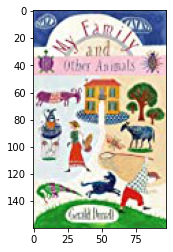

Такие рекомендации


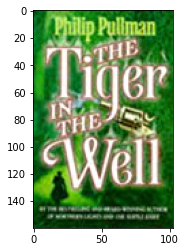

Такие рекомендации


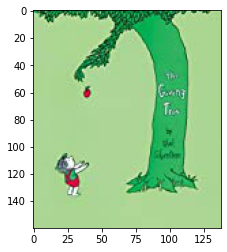

Такие рекомендации


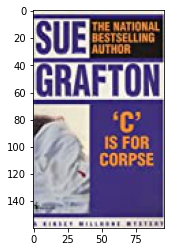

Такие рекомендации


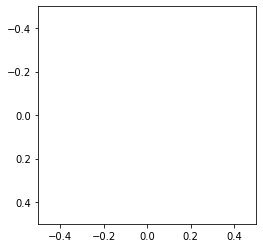

Такие рекомендации


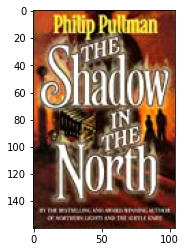

Такие рекомендации


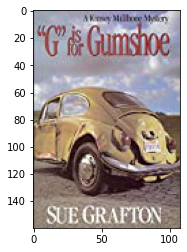

Такие рекомендации


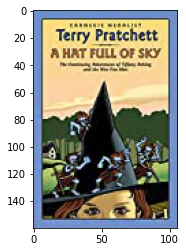

Такие рекомендации


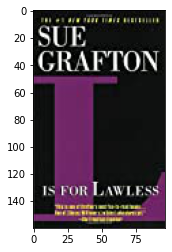

Такие рекомендации


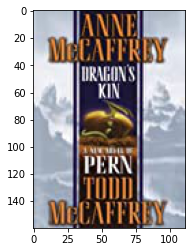

Такие рекомендации


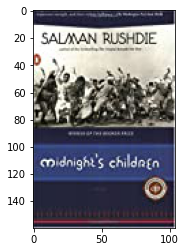

Такие рекомендации


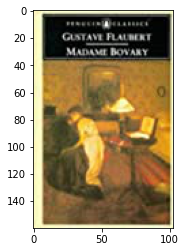

,Book-Title,picture_url,product_id,Rating(mean),Users_num(other age groups),Top_place
ISBN,,,,,,
0380791978,The Family Tree,http://images.amazon.com/images/P/0380791978.0...,2964,10,19,1
0765345048,Kushiel's Chosen (Kushiel's Legacy),http://images.amazon.com/images/P/0765345048.0...,8689,10,14,2
0140013997,My Family and Other Animals.,http://images.amazon.com/images/P/0140013997.0...,787,10,12,3
0439010799,The Tiger in the Well,http://images.amazon.com/images/P/0439010799.0...,4148,10,7,4
0060256664,The Giving Tree,http://images.amazon.com/images/P/0060256664.0...,174,10,6,5
0553280368,C Is for Corpse (Kinsey Millhone Mysteries (Pa...,http://images.amazon.com/images/P/0553280368.0...,6468,9,54,6
1853260622,War and Peace (Wordsworth Classics),http://images.amazon.com/images/P/1853260622.0...,10082,9,11,7
0439010780,The Shadow in the North,http://images.amazon.com/images/P/0439010780.0...,4147,9,8,8
0805004610,G Is for Gumshoe: A Kinsey Millhone Mystery (G...,http://images.amazon.com/images/P/0805004610.0...,9002,9,7,9


In [ ]:
pers_top_books(40, 'london, england, united kingdom', False)

### Задание 2. Рекомендации с помощью кластеров

In [ ]:
from sklearn.cluster import DBSCAN, KMeans
from sklearn.neighbors import NearestNeighbors

In [ ]:
interactions.head(2)

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,3426
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,5220


In [ ]:
interactions['User-ID'].value_counts()

258534    154
76151     150
21014     140
273113    135
227520    119
         ... 
236655      1
123149      1
110919      1
63918       1
61494       1
Name: User-ID, Length: 10902, dtype: int64

In [ ]:
cross_inter = pd.pivot_table(interactions, columns = 'ISBN', index = 'User-ID', values = 'Book-Rating').reset_index()

In [ ]:
cross_inter[cross_inter['User-ID'] == 258534].notnull().sum().sum()

155

In [ ]:
cross_inter.fillna(0, inplace = True)
interactions[interactions['User-ID'] == 258534]

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
5168,258534,0312966970,9,103,196,http://images.amazon.com/images/P/0312966970.0...,Four To Score (A Stephanie Plum Novel),1492,10159
5311,258534,0553280341,9,83,196,http://images.amazon.com/images/P/0553280341.0...,B Is for Burglar (Kinsey Millhone Mysteries (P...,6467,10159
5519,258534,0553271636,8,60,196,http://images.amazon.com/images/P/0553271636.0...,D Is for Deadbeat (Kinsey Millhone Mysteries (...,6405,10159
6632,258534,0446605484,8,85,196,http://images.amazon.com/images/P/0446605484.0...,Roses Are Red (Alex Cross Novels),4919,10159
6720,258534,0440241073,9,200,196,http://images.amazon.com/images/P/0440241073.0...,The Summons,4491,10159
...,...,...,...,...,...,...,...,...,...
99856,258534,0451193881,9,10,196,http://images.amazon.com/images/P/0451193881.0...,The Shining,5455,10159
99862,258534,0451117298,8,11,196,http://images.amazon.com/images/P/0451117298.0...,Cujo,5275,10159
99869,258534,0553560204,10,11,196,http://images.amazon.com/images/P/0553560204.0...,The Lesson of Her Death,6604,10159
99877,258534,0440220688,8,12,196,http://images.amazon.com/images/P/0440220688.0...,Motion to Suppress,4348,10159


In [ ]:
cross_inter

ISBN,User-ID,0002005018,0002251760,000648302X,0006551971,0006742939,0007110928,0007122039,0007141076,0007154615,000716226X,0007170866,0020125305,0020198817,0020198906,0020199600,002026478X,0020306652,0020360754,0020418809,0020427859,0020442009,0020442106,0020442203,0020442300,0020442408,0020442505,0020442602,0020446500,0020449313,0020518501,0020518609,0020518706,0020519001,0020532105,0020868308,002411510X,0024182001,002542730X,0028603958,...,8478884459,8478884955,8478885196,8478886451,8478886508,8478950257,8483101610,8484505294,8484602508,8495359537,8495501074,8495501090,8495501112,8495501198,8495501252,849550152X,8495618605,8804342838,8804370874,8804375914,8806142100,8806143042,880781000X,880781076X,8807810778,880781210X,8807812576,8807813025,881787017X,8838910170,8838918600,8845247414,8845407039,8885989403,9074336329,950491036X,9681500555,968150108X,9681501225,9726101794
0,8,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,99,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,114,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,242,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,243,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10897,278668,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10898,278694,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10899,278843,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10900,278851,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

#### Построение кластеров

Метод локтя для подбора параметров для DBSCAN.

In [ ]:
k_neib = 100
metr = 'cosine'
nn = NearestNeighbors(k_neib, metric = metr)

In [ ]:
nn.fit(csr_rates)

NearestNeighbors(algorithm='auto', leaf_size=30, metric='cosine',
                 metric_params=None, n_jobs=None, n_neighbors=100, p=2,
                 radius=1.0)

In [ ]:
d, id_x = nn.kneighbors(csr_rates, return_distance=True)
d

array([[0.00000000e+00, 4.68746798e-01, 5.74804797e-01, ...,
        1.00000000e+00, 1.00000000e+00, 1.00000000e+00],
       [2.22044605e-16, 4.08687604e-01, 5.38262593e-01, ...,
        9.81439744e-01, 1.00000000e+00, 1.00000000e+00],
       [2.22044605e-16, 5.75809168e-01, 6.01257836e-01, ...,
        8.64477742e-01, 8.65218981e-01, 8.65312315e-01],
       ...,
       [1.11022302e-16, 6.82988521e-01, 7.18212019e-01, ...,
        8.72053002e-01, 8.72701166e-01, 8.72830864e-01],
       [0.00000000e+00, 4.18147195e-01, 5.49195157e-01, ...,
        1.00000000e+00, 1.00000000e+00, 1.00000000e+00],
       [2.22044605e-16, 5.09286713e-01, 6.32088168e-01, ...,
        9.80154597e-01, 1.00000000e+00, 1.00000000e+00]])

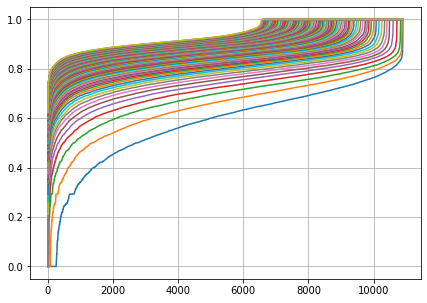

In [ ]:
plt.figure(figsize = (7, 5))
for i in range(1, k_neib):
  e1 = d[:, i]
  e1.sort()
  plt.plot(e1)
plt.grid(True)

In [ ]:
dbscan = DBSCAN(0.63, min_samples = 15, metric='cosine')

In [ ]:
dbscan.fit(csr_rates)

DBSCAN(algorithm='auto', eps=0.63, leaf_size=30, metric='cosine',
       metric_params=None, min_samples=15, n_jobs=None, p=None)

In [ ]:
labels = dbscan.labels_
np.unique(labels, return_counts = True), (labels == -1).sum()/labels.shape[0]
# метки кластера

((array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
         16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
         33, 34, 35, 36, 37, 38]),
  array([9118,  602,  414,   27,   19,   17,   20,   16,   56,   29,   15,
           31,   13,   18,   17,   20,   17,   36,   15,   18,   20,   18,
           27,   17,   20,   28,   18,   25,   16,    9,   15,   15,   13,
           19,   11,   25,   24,   35,   16,   13])),
 0.8363603008622271)

DBSCAN ничего путевого не дал сколько не пробовал, пошел через простой k-means

In [ ]:
km = KMeans(n_clusters=20, n_init = 100, algorithm = 'full', 
            precompute_distances = True, n_jobs = -1)

In [ ]:
km.fit(csr_rates)

KMeans(algorithm='full', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=20, n_init=100, n_jobs=-1, precompute_distances=True,
       random_state=None, tol=0.0001, verbose=0)

In [ ]:
labels = km.labels_
uniq = np.unique(labels, return_counts = True)
uniq, (labels == -1).sum()/labels.shape[0]
# метки кластера

((array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
         17, 18, 19], dtype=int32),
  array([  58,   15,    1,  289,   55,   29,    1,    1,    1,    1,    1,
         9994,    1,    1,    1,    1,    1,   14,    1,  436])),
 0.0)

Кластеров только 9 (остальные можно считать за выбросы)

In [ ]:
cross_inter['label'] = labels

In [ ]:
start_t = pd.DataFrame(cross_inter[cross_inter.label == 0].mean()[cross_inter[cross_inter.label == 0].mean().notnull()])

In [ ]:
for lab in uniq[0][1:]:
  if uniq[1][lab] > 3:
    start_t = start_t.merge(pd.DataFrame(cross_inter[cross_inter.label == lab].mean()[cross_inter[cross_inter.label == lab].mean().notnull()]), 
                            how = 'outer', on = ['ISBN'])

In [ ]:
start_t.columns = (start_t.loc['label', :]).astype('int8')
start_t.fillna(0, inplace = True)
start_t.drop('label', axis = 0, inplace = True)

In [ ]:
dict_rec = {}
for col in start_t.columns:
  dict_rec[col] = start_t[col][1:].sort_values(ascending = False)[:10]

In [ ]:
for rec in dict_rec.keys():
  print(f'\nДля пользователей из кластера = {rec} топ10 книг:')
  display(interactions[interactions.ISBN.isin(dict_rec[rec].index)]['Book-Title'].drop_duplicates().values)


Для пользователей из кластера = 0 топ10 книг:


array(['The Lost World', 'Sphere', 'Congo', 'Jurassic Park', 'Airframe',
       'A Case of Need', 'Silence of the Lambs', 'Rising Sun',
       'A Time to Kill', 'Disclosure'], dtype=object)


Для пользователей из кластера = 1 топ10 книг:


array(['B Is for Burglar (Kinsey Millhone Mysteries (Paperback))',
       'D Is for Deadbeat (Kinsey Millhone Mysteries (Paperback))',
       'C Is for Corpse (Kinsey Millhone Mysteries (Paperback))',
       'H Is for Homicide (Kinsey Millhone Mysteries (Paperback))',
       'E Is for Evidence: A Kinsey Millhone Mystery (Kinsey Millhone Mysteries (Paperback))',
       'I Is for Innocent',
       'F Is for Fugitive (Kinsey Millhone Mysteries (Paperback))',
       'G Is for Gumshoe (Kinsey Millhone Mysteries (Paperback))',
       'J Is for Judgment',
       'K Is for Killer (Kinsey Millhone Mysteries (Paperback))'],
      dtype=object)


Для пользователей из кластера = 3 топ10 книг:


array(['Harry Potter and the Order of the Phoenix (Book 5)',
       "Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))",
       'Harry Potter and the Chamber of Secrets (Book 2)',
       'The Da Vinci Code',
       'Harry Potter and the Goblet of Fire (Book 4)',
       "Harry Potter and the Sorcerer's Stone (Book 1)",
       'Harry Potter and the Prisoner of Azkaban (Book 3)'], dtype=object)


Для пользователей из кластера = 4 топ10 книг:


array(['Four To Score (A Stephanie Plum Novel)',
       'One for the Money (Stephanie Plum Novels (Paperback))',
       'Seven Up (A Stephanie Plum Novel)',
       'To the Nines: A Stephanie Plum Novel',
       'Hot Six : A Stephanie Plum Novel (A Stephanie Plum Novel)',
       'Three To Get Deadly : A Stephanie Plum Novel (A Stephanie Plum Novel)',
       'Two for the Dough',
       'Hard Eight : A Stephanie Plum Novel (A Stephanie Plum Novel)',
       'High Five (A Stephanie Plum Novel)',
       'One for the Money (A Stephanie Plum Novel)'], dtype=object)


Для пользователей из кластера = 5 топ10 книг:


array(['The Lovely Bones: A Novel', 'I Know This Much Is True',
       'The Da Vinci Code',
       "She's Come Undone (Oprah's Book Club (Paperback))",
       'The Red Tent (Bestselling Backlist)',
       "Where the Heart Is (Oprah's Book Club (Paperback))",
       'Divine Secrets of the Ya-Ya Sisterhood: A Novel',
       'The Nanny Diaries: A Novel', "Bridget Jones's Diary",
       "Dude, Where's My Country?"], dtype=object)


Для пользователей из кластера = 11 топ10 книг:


array(['The Five People You Meet in Heaven', 'The Secret Life of Bees',
       'Angels &amp; Demons', 'Interview with the Vampire',
       'The Da Vinci Code', 'Life of Pi',
       'The Red Tent (Bestselling Backlist)',
       "Where the Heart Is (Oprah's Book Club (Paperback))",
       'Divine Secrets of the Ya-Ya Sisterhood: A Novel',
       'Girl with a Pearl Earring'], dtype=object)


Для пользователей из кластера = 17 топ10 книг:


array(['Guilty Pleasures (Anita Blake Vampire Hunter (Paperback))',
       'Burnt Offerings (Anita Blake, Vampire Hunter)',
       'Killing Dance (Anita Blake Vampire Hunter (Paperback))',
       'Circus of the Damned (Anita Blake Vampire Hunter (Paperback))',
       'Bloody Bones (Anita Blake Vampire Hunter (Paperback))',
       'Blue Moon (Anita Blake Vampire Hunter)',
       'Narcissus in Chains (Anita Blake Vampire Hunter (Hardcover))',
       'The Laughing Corpse (Anita Blake Vampire Hunter (Paperback))',
       'Obsidian Butterfly',
       'The Lunatic Cafe (Anita Blake Vampire Hunter (Paperback))'],
      dtype=object)


Для пользователей из кластера = 19 топ10 книг:


array(['The Lovely Bones: A Novel', "The Pilot's Wife : A Novel",
       'The Secret Life of Bees', 'The Poisonwood Bible: A Novel',
       'The Da Vinci Code', 'Life of Pi',
       'The Red Tent (Bestselling Backlist)',
       "Where the Heart Is (Oprah's Book Club (Paperback))",
       'Good in Bed', 'Girl with a Pearl Earring'], dtype=object)

In [ ]:
interactions = interactions.merge(cross_inter[['label', 'User-ID']], on = 'User-ID')

In [ ]:
interactions.label.isnull().sum()

0

In [ ]:
class Rec_clusters():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int

    def get_rec_clust(self, idx):
      clust = self.interactions[self.interactions.vid == idx].label.values[0]
      if self.interactions.label.value_counts()[clust] < 3:
        print('Данный пользователь не попал ни в один кластер')
      else:
        its = self.interactions[self.interactions.label == clust].groupby('product_id')['Book-Rating'].sum()/(self.interactions.label.value_counts()[clust])
        its = its.reset_index().sort_values(by = 'Book-Rating', ascending = False)[:10]
        rec_imaging(its['product_id'].values, self.product_id_to_url, its['Book-Rating'].values)

In [ ]:
top_clust = Rec_clusters(interactions[interactions['Book-Rating'] > 5])

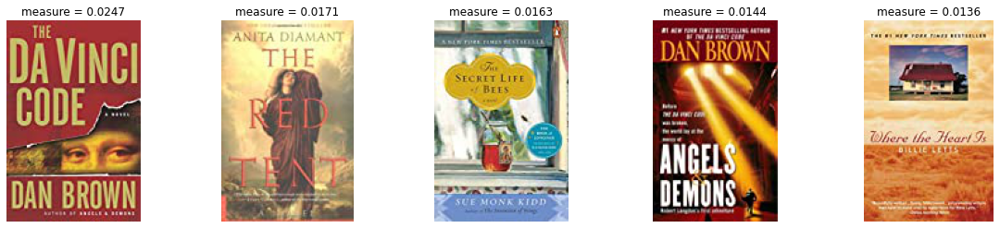

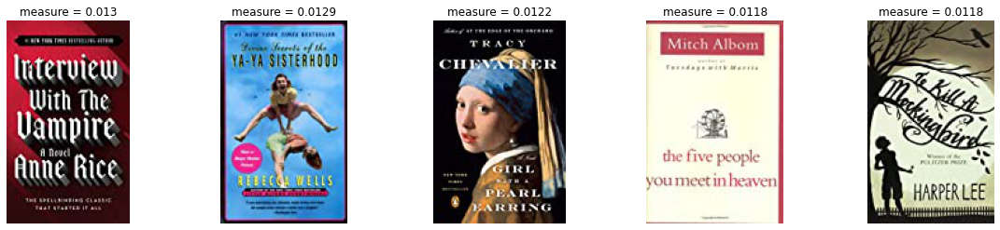

In [ ]:
top_clust.get_rec_clust(1)

### Задание 3

In [ ]:
ne = new_books.rename(columns = {"Image-URL-M": "picture_url", 
                                 "Book-Title": "text"})
inte = interactions.rename(columns = {"Book-Title": "text"})
ne.text.isnull().sum(), inte.shape

(0, (109538, 9))

#### Content-based

In [ ]:
interactions[interactions['Book-Title'] == 'Harry Potter and the Chamber of Secrets (Book 2)'].head(3)

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
3264,22625,0439064864,10,126,98,http://images.amazon.com/images/P/0439064864.0...,Harry Potter and the Chamber of Secrets (Book 2),4153,820
3265,75819,0439064864,7,126,112,http://images.amazon.com/images/P/0439064864.0...,Harry Potter and the Chamber of Secrets (Book 2),4153,2996
3266,116904,0439064864,10,126,36,http://images.amazon.com/images/P/0439064864.0...,Harry Potter and the Chamber of Secrets (Book 2),4153,4624


In [ ]:
interactions.head(3)

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,3426
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,5220
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,2608


In [ ]:
new_books.head(3)

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...


In [ ]:
# надо запустить ячейку с классом из семинара
ContBased = Content_Based(ne, inte)

In [ ]:
ContBased.get_items_representation()

Для товара


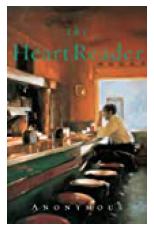

Такие рекомендации


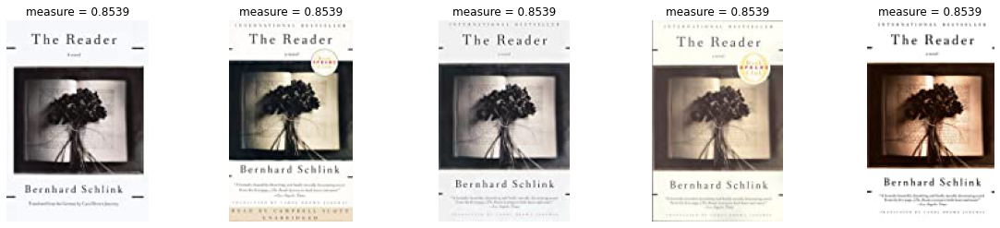

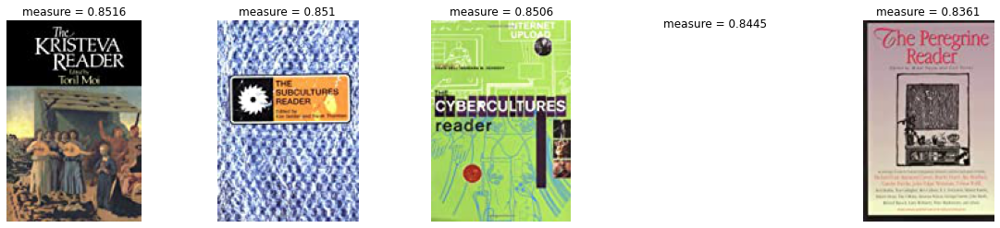

In [ ]:
ContBased.get_rec_I2I(4153)

Для пользователя, который взаимодействовал с товарами


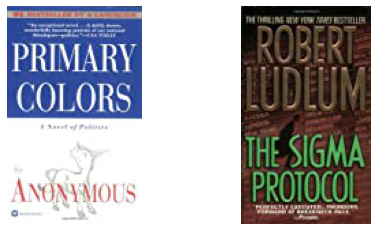

Такие рекомендации


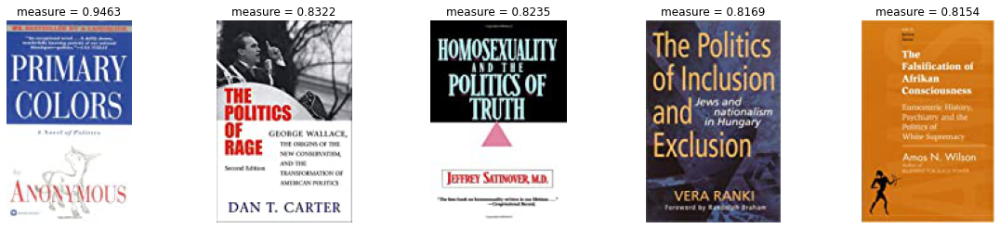

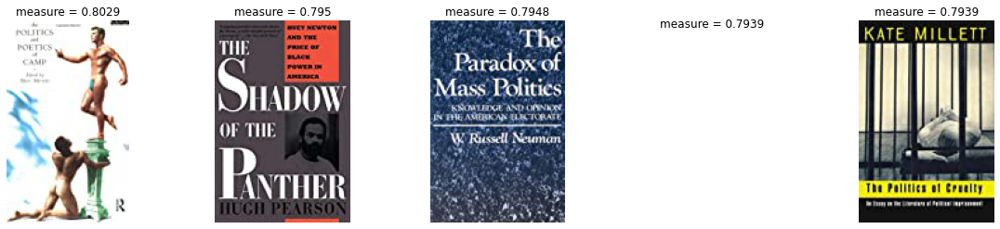

In [ ]:
ContBased.get_rec_U2I(4153)

#### Совстречаемость

In [ ]:
class Recomendations():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()
        # Для каждого пользователя собираем товары, с которыми он взамиодействовал
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        # Считаем число товаров, с которыми взаимодействовал каждый пользователь и записываем в колонку prod_num
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        # Фильтруем пользователей, взаимодействовавших с одним товаром
        user_products = user_products[user_products["prod_num"] > 1]
        
        # Заводим словарь под товары
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
        cooc_list = []
        for i, j in cooc.items():
            # Если товары встетились вместе больше одного раза, то добавляем в список
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        
        if recs.shape[0] == 0:
          print('Товары с такими id не найдены')
        
        else:
          print(u"Для товара")
          rec_imaging([i], self.product_id_to_url)
        

          print(u"Такие рекомендации")
          rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                          recs["measure"].values.astype(int))       
          display(recs)

In [ ]:
cooc_rec = Recomendations(inte)
cooc_rec.coocurrency_count()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


In [ ]:
cooc_rec.cooc_rec

,item1,item2,measure
0,7291,4999,2
1,7291,4949,3
2,7291,5560,3
3,7291,6877,2
4,4999,7291,2
...,...,...,...
232955,5203,2210,2
232956,2210,7180,2
232957,2210,5203,2
232958,8946,9799,2


Для товара


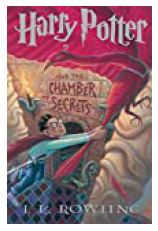

Такие рекомендации


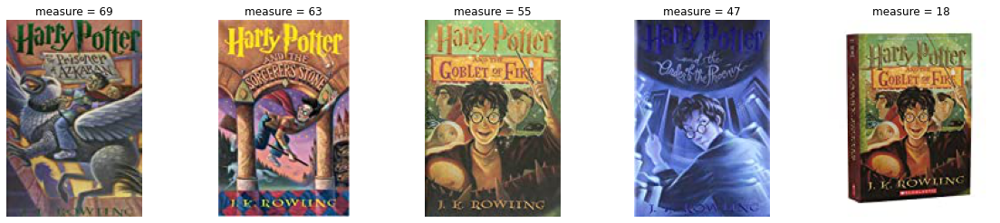

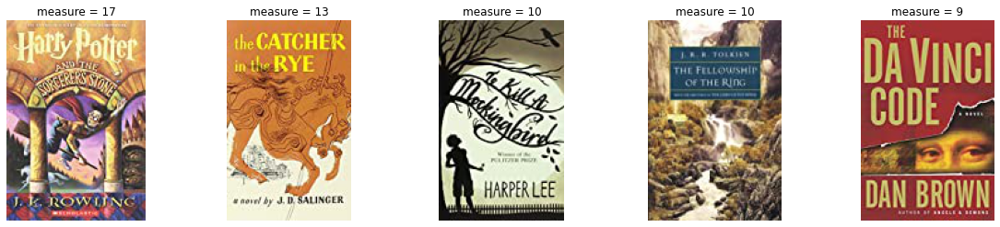

,item1,item2,measure
155,4153,4161,69
153,4153,6949,63
152,4153,4163,55
1805,4153,4170,47
82428,4153,4164,18
37519,4153,6950,17
23636,4153,1675,13
57729,4153,4696,10
162,4153,7069,10
106937,4153,3401,9


In [ ]:
# вроде неплохие рекомендации
cooc_rec.get_rec(4153)

#### Матричная факторизация

In [ ]:
interactions.head(1)

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid,label
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,3426,11


In [ ]:
class MatrixFactorization_():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        self.interactions = interactions
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        self.csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["text"])

        #user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        #user_emb = self.user_feature_embeddings(user_processed, self.model, 200, self.index2word_set)

        user_processed , user_emb = self.user_feature_bias, self.user_feature_embeddings 
        metrics = cosine_similarity(user_emb, self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

Для товара


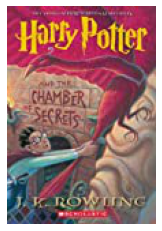

Такие рекомендации


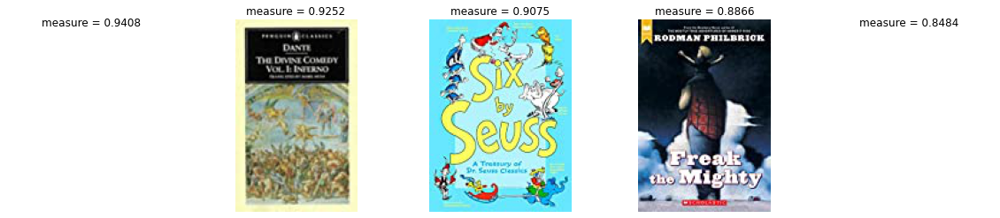

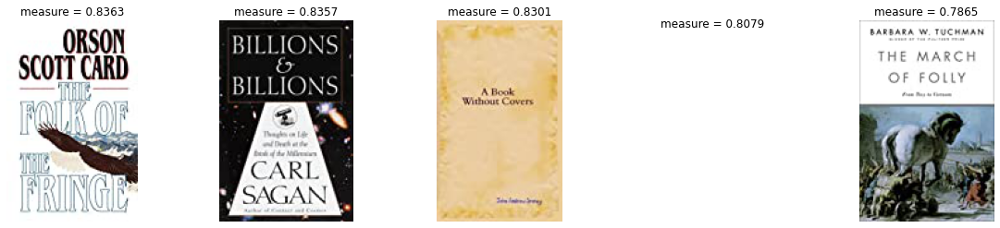

In [ ]:
simple_svd = MatrixFactorization_(inte, 30)
simple_svd.MF()
simple_svd.get_rec_I2I(4153)

Epoch: 100%|██████████| 5/5 [00:03<00:00,  1.31it/s]


Для товара


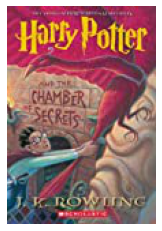

Такие рекомендации


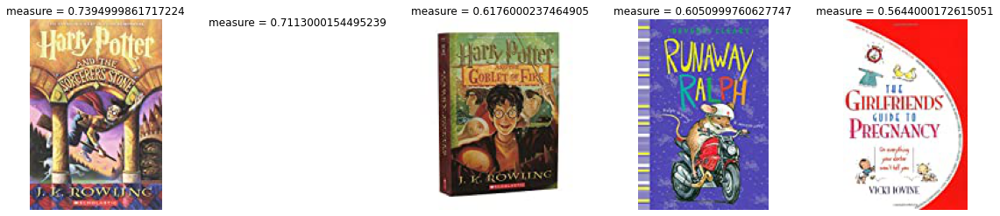

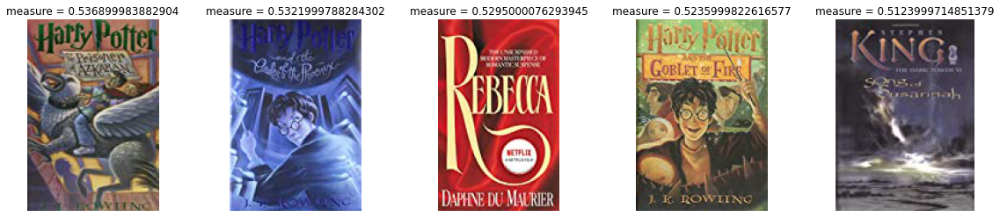

In [ ]:
simple_svd = MatrixFactorization_(inte, 30)
simple_svd.LightFM()
simple_svd.get_rec_I2I(4153)

Довольно нетрудно заметить, что с помощью метода LightFM, мы получаем рекоиендации заметно лучше, чем у обучного svd-разложения(к книге Гарри Поттера в первом случае svds ни одной книги других частей из ГАрри Поттера, а вот c LightFM уже сразу видно несколько других частей Гарри Поттера в рекомендациях.)

Epoch: 100%|██████████| 5/5 [00:03<00:00,  1.31it/s]


Для пользователя, который взаимодействовал с товарами


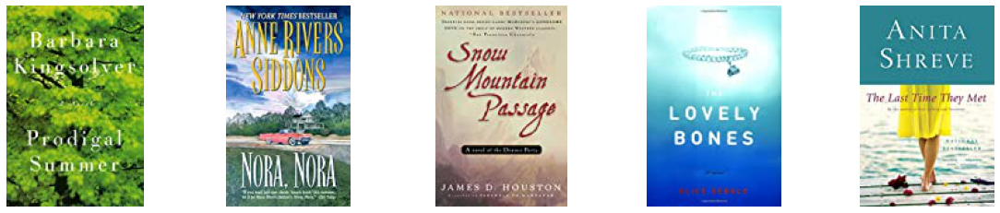

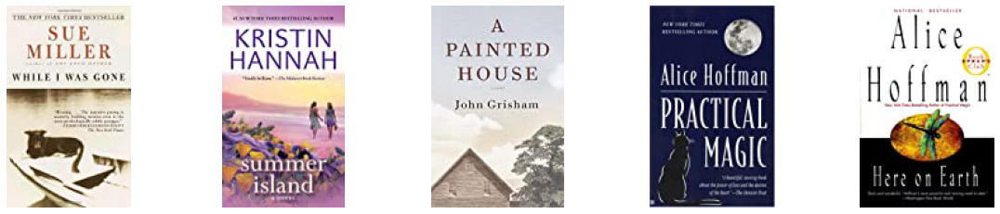

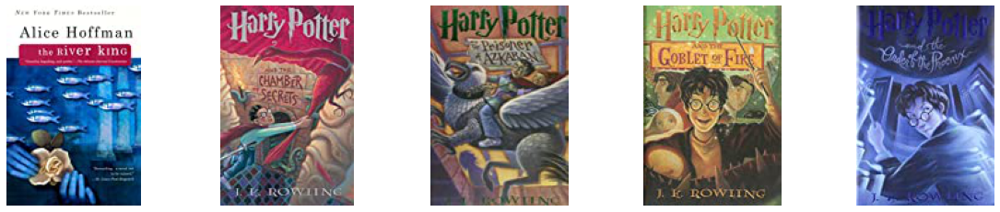

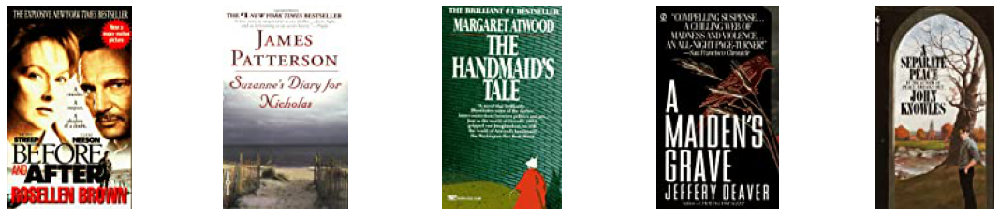

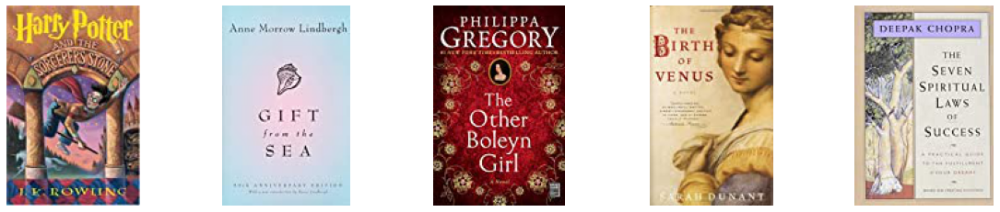

Такие рекомендации


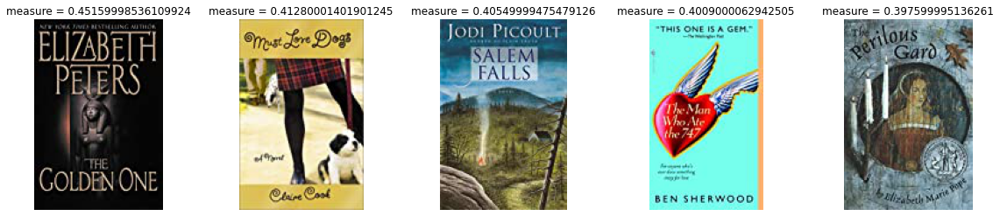

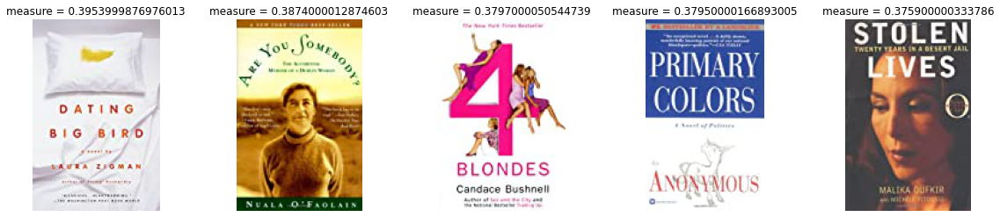

In [ ]:
simple_svd = MatrixFactorization_(inte, 30)
simple_svd.LightFM()
simple_svd.get_rec_U2I(4624)

#### Коллаборативная фильтрация

In [ ]:
# черновик
user_rates = csr_rates.getrow(10).toarray()
watched_items = np.where(user_rates[0] != 0)[0]
metrics = cosine_similarity(user_rates, csr_rates).reshape(-1, 1)

# вычитаем среднее из строк 
#csr_rates = 

tot = np.array(csr_rates.sum(axis=1).squeeze())[0]
cts = np.diff(csr_rates.indptr)
mu = tot/cts
d = sp.diags(mu, 0)
b = csr_rates.copy()
b.data = np.ones_like(b.data)
#display((csr_rates - d*b).todense())

csr_mean_rates = csr_rates - d*b
# домножаем оценки пользователя на коэффициент похожести
rates = csr_matrix.multiply(csr_mean_rates.copy(), metrics)

a = (rates.sum(axis = 0)/metrics.sum()).ravel()
a.sort()
rates

In [ ]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j

        self.csr_rates = csr_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))
        

    def user_based(self, idx):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        # считаем косинус между пользователем idx и всеми пользователями
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)

        # вычитаем среднее из строк разреженной матрицы
        tot = np.array(self.csr_rates.sum(axis=1).squeeze())[0]
        cts = np.diff(self.csr_rates.indptr)
        mu = tot/cts
        d = sp.diags(mu, 0)
        b = csr_rates.copy()
        b.data = np.ones_like(b.data)
        self.csr_rates = csr_rates - d*b

        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
        
    def item_based(self, idx):
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        # считаем косинус между товаром idx и всеми пользователями
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)

        # вычитаем среднее из строк разреженной матрицы
        tot = np.array(self.csr_rates.sum(axis=1).squeeze())[0]
        cts = np.diff(self.csr_rates.indptr)
        mu = tot/cts
        d = sp.diags(mu, 0)
        b = csr_rates.copy()
        b.data = np.ones_like(b.data)
        self.csr_rates = csr_rates - d*b

        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

Для таких товаров


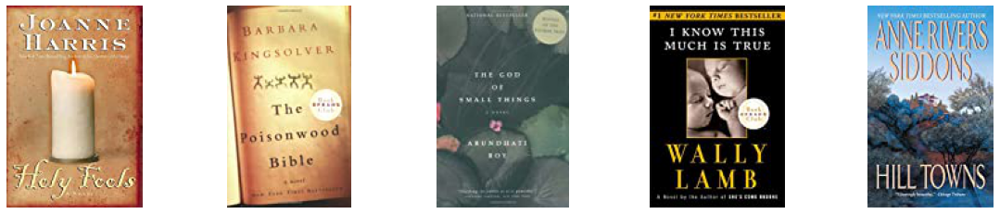

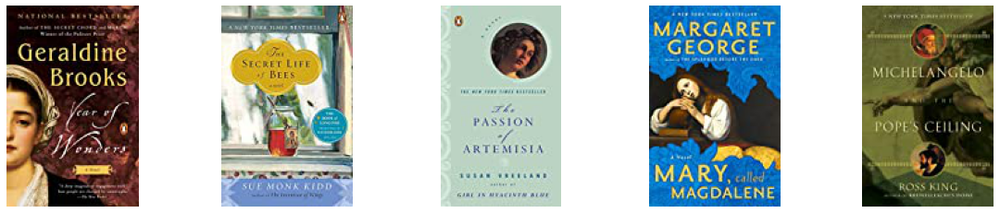

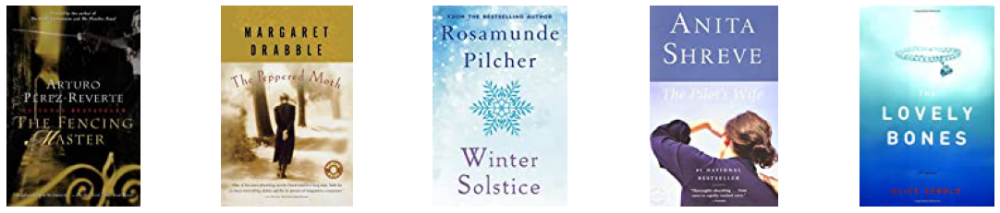

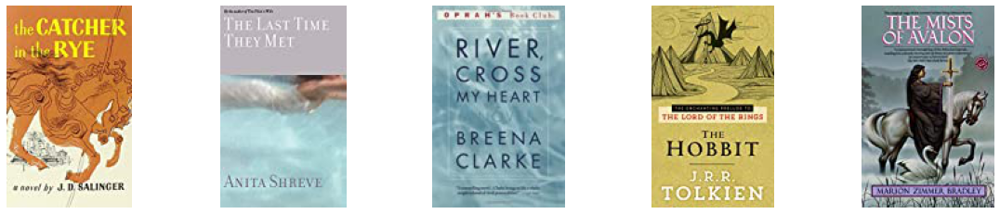

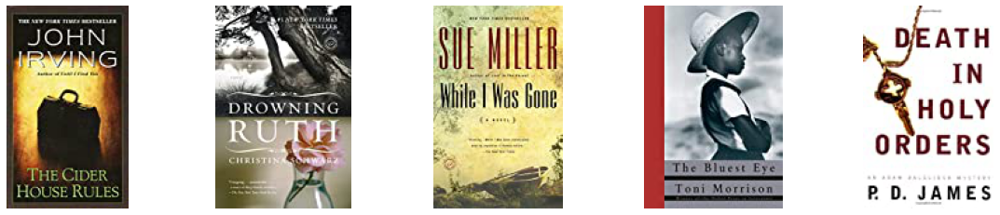

...

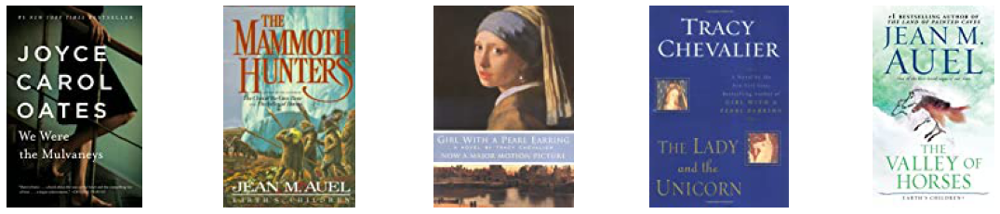

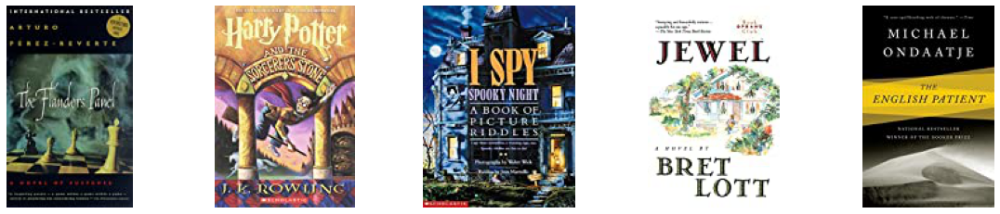

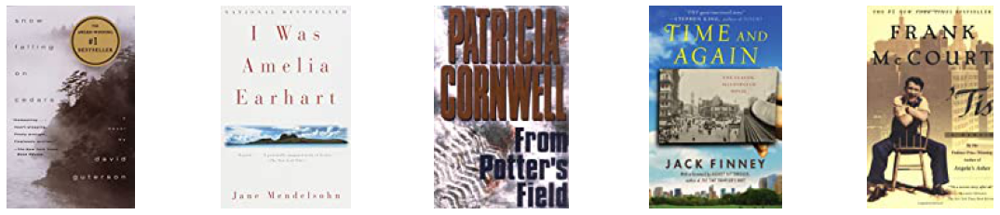

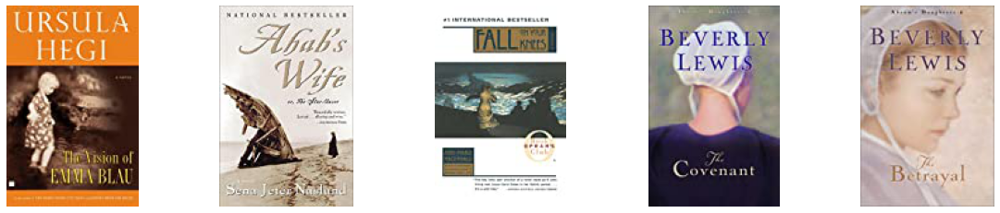

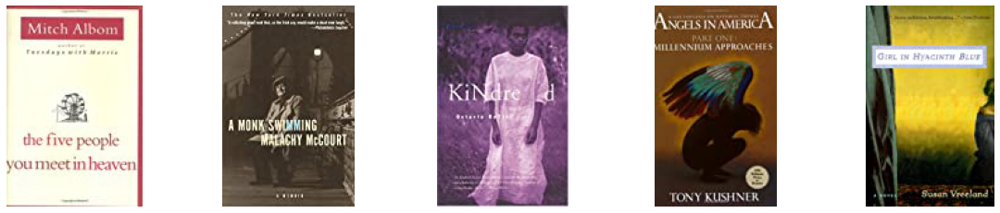

Такие рекомендации


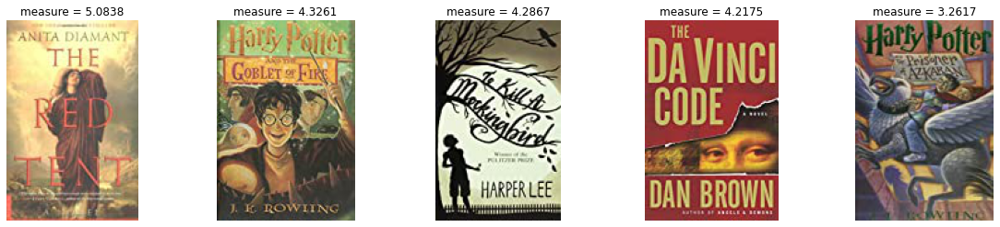

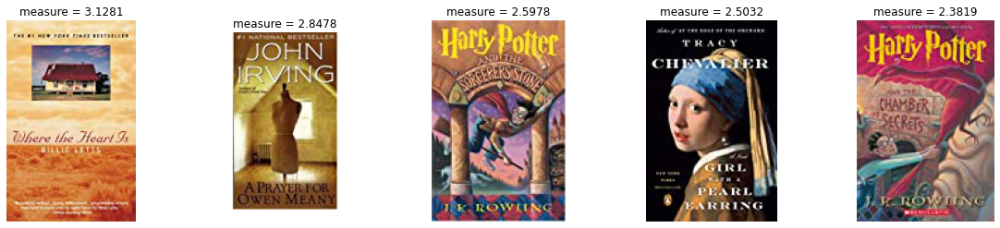

In [ ]:
clb = Colloborative(interactions)
# метод get_rec_U2I
clb.user_based(820)

Нашел этого человека по книгам Гарри Поттера, он их прочел 3 штуки вроде как. Советуем ему тоже другие части из ГАрри Поттера. Остальные книги по тематике вроде тоже подходят.

Для таких товаров


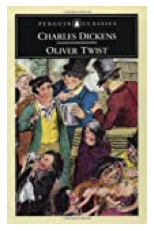

Такие рекомендации


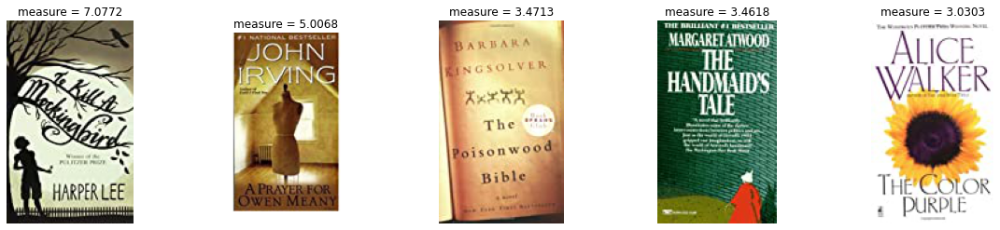

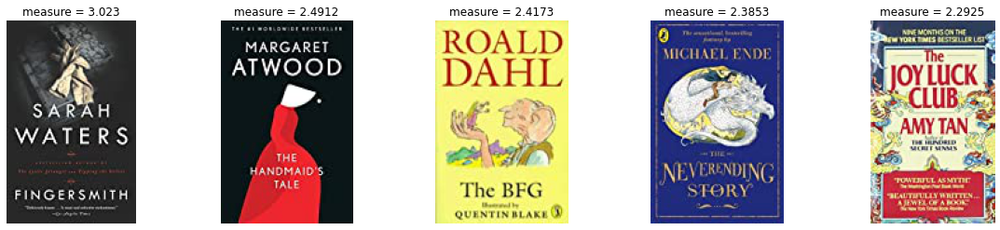

In [ ]:
clb = Colloborative(interactions)
# метод get_rec_I2I
clb.item_based(1020)

Визуально get_rec_I2I работает лучше чем get_rec_U2I